<a href="https://colab.research.google.com/github/dp913/CSE-541-Computer-Vision-2023-Group-8/blob/master/Code/Models_Performance_Comparison.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Data distribution
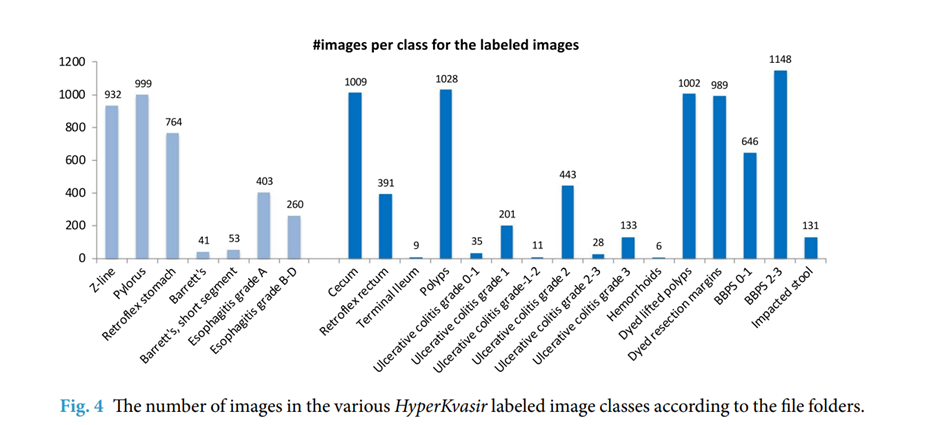

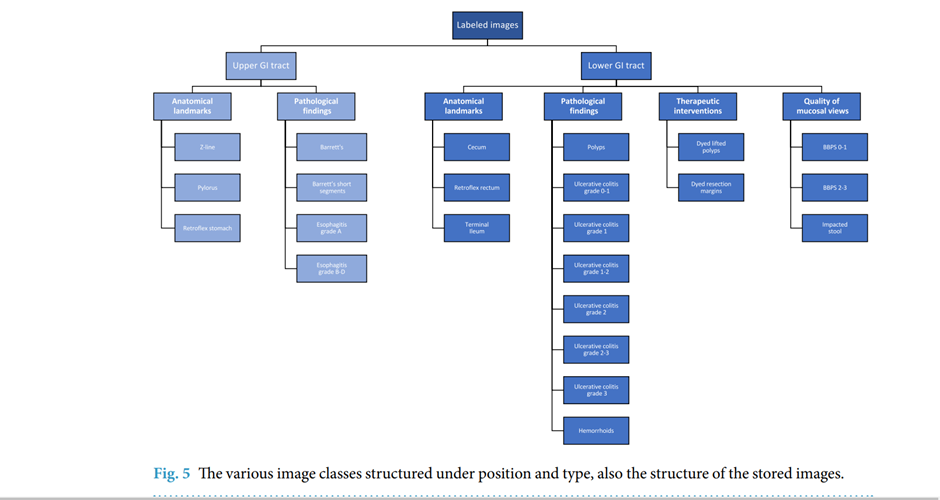

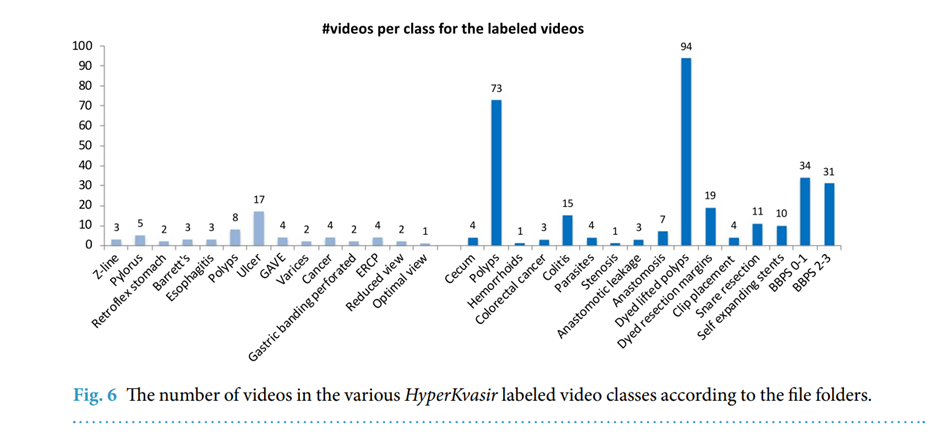


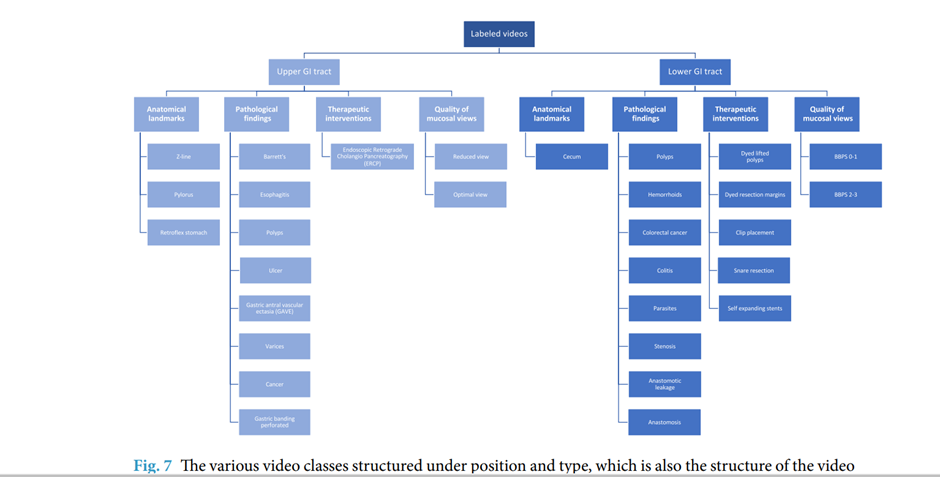


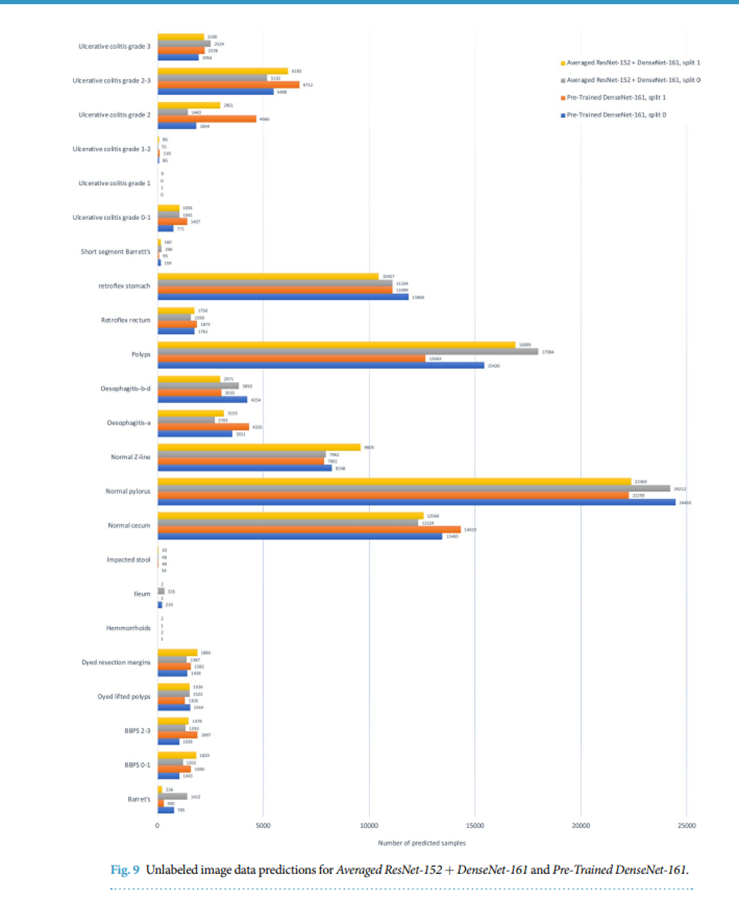




In [ ]:
import tensorflow as tf
import tensorflow_datasets as tfds
import pathlib
import pathlib
import pandas as pd
import PIL
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Dropout, MaxPooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers.experimental import preprocessing
from sklearn.model_selection import train_test_split
from tensorflow.keras.applications import DenseNet169
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.applications import EfficientNetB7
import IPython.display as display
from PIL import Image
import os,shutil
from google.colab import drive
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
!wget "https://datasets.simula.no/downloads/hyper-kvasir/hyper-kvasir-labeled-images.zip"
!unzip hyper-kvasir-labeled-images.zip

In [ ]:
!git clone https://github.com/simula/hyper-kvasir.git

Cloning into 'hyper-kvasir'...
remote: Enumerating objects: 72, done.
remote: Counting objects: 100% (15/15), done.
remote: Compressing objects: 100% (15/15), done.
remote: Total 72 (delta 7), reused 1 (delta 0), pack-reused 57
Unpacking objects: 100% (72/72), 45.33 MiB | 7.72 MiB/s, done.
Updating files: 100% (33/33), done.


In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
batch_size = 32
img_height = 244
img_width = 244

In [ ]:
base_dir = '/content/drive/MyDrive/split_dataset'
train_dir = os.path.join(base_dir, 'train')
test_dir = os.path.join(base_dir, 'test')
val_dir = os.path.join(base_dir, 'val')
data_dir = train_dir

In [ ]:
os.listdir(train_dir)

['Ulcerative-colitis', 'Polyps', 'Barrett_s', 'Esophagitis', 'Hemorrhoids']

In [ ]:
os.listdir(val_dir)

['Ulcerative-colitis', 'Barrett_s', 'Polyps', 'Esophagitis', 'Hemorrhoids']

In [ ]:
def get_dataCategories(directory):
    """
        get the categories (class) of the dataset from the path of the dataset
        in question.

    args:
        dataset_dir (str): dataset path

    Returns:
        list: list of categories
        list: list of number of files by categories
    """
    import glob

    categories = []
    for folder_name in os.listdir(directory):
        if os.path.isdir(os.path.join(directory, folder_name)):
            nbr_files = len(
                glob.glob(os.path.join(directory, folder_name) + "/*.jpg")
            )
            categories.append(np.array([folder_name, nbr_files]))

    categories.sort(key=lambda a: a[0])
    cat = np.array(categories)

    return list(cat[:, 0]), list(cat[:, 1])
    
directory = train_dir
categories, nbr_files = get_dataCategories(directory)

# Create DataFrame
df = pd.DataFrame({"categories": categories, "number of files": nbr_files})
print("number of categories: ", len(categories))
df


number of categories:  5


,categories,number of files
0,Barrett_s,56
1,Esophagitis,397
2,Hemorrhoids,3
3,Polyps,616
4,Ulcerative-colitis,510


In [ ]:
def get_dataCategories(directory):
    """
        get the categories (class) of the dataset from the path of the dataset
        in question.

    args:
        dataset_dir (str): dataset path

    Returns:
        list: list of categories
        list: list of number of files by categories
    """
    import glob

    categories = []
    for folder_name in os.listdir(directory):
        if os.path.isdir(os.path.join(directory, folder_name)):
            nbr_files = len(
                glob.glob(os.path.join(directory, folder_name) + "/*.jpg")
            )
            categories.append(np.array([folder_name, nbr_files]))

    categories.sort(key=lambda a: a[0])
    cat = np.array(categories)

    return list(cat[:, 0]), list(cat[:, 1])
    
directory = val_dir
categories, nbr_files = get_dataCategories(directory)

# Create DataFrame
df = pd.DataFrame({"categories": categories, "number of files": nbr_files})
print("number of categories: ", len(categories))
df


number of categories:  5


,categories,number of files
0,Barrett_s,18
1,Esophagitis,132
2,Hemorrhoids,1
3,Polyps,205
4,Ulcerative-colitis,156


In [ ]:
def get_dataCategories(directory):
    """
        get the categories (class) of the dataset from the path of the dataset
        in question.

    args:
        dataset_dir (str): dataset path

    Returns:
        list: list of categories
        list: list of number of files by categories
    """
    import glob

    categories = []
    for folder_name in os.listdir(directory):
        if os.path.isdir(os.path.join(directory, folder_name)):
            nbr_files = len(
                glob.glob(os.path.join(directory, folder_name) + "/*.jpg")
            )
            categories.append(np.array([folder_name, nbr_files]))

    categories.sort(key=lambda a: a[0])
    cat = np.array(categories)

    return list(cat[:, 0]), list(cat[:, 1])
    
directory = test_dir
categories, nbr_files = get_dataCategories(directory)

# Create DataFrame
df = pd.DataFrame({"categories": categories, "number of files": nbr_files})
print("number of categories: ", len(categories))
df


number of categories:  5


,categories,number of files
0,Barrett_s,20
1,Esophagitis,134
2,Hemorrhoids,2
3,Polyps,207
4,Ulcerative-colitis,171


In [ ]:
train_ds = tf.keras.preprocessing.image_dataset_from_directory(
  train_dir,
  seed=123,
  image_size=(img_width, img_height),
  batch_size=batch_size,
  label_mode = 'categorical')

Found 1582 files belonging to 5 classes.


In [ ]:
val_ds = tf.keras.preprocessing.image_dataset_from_directory(
  val_dir,
  seed=123,
  image_size=(img_width, img_height),
  batch_size=batch_size,
  label_mode = 'categorical')

Found 512 files belonging to 5 classes.


In [ ]:
test_ds = tf.keras.preprocessing.image_dataset_from_directory(
  test_dir,
  seed=123,
  image_size=(img_width, img_height),
  batch_size=batch_size,
  label_mode = 'categorical')

Found 534 files belonging to 5 classes.


In [ ]:
def norm_data (ds):
  prepr_layer = tf.keras.layers.experimental.preprocessing.Rescaling(1./255)
  #norm_ds = layer(ds)
  norm_ds = ds.map(lambda x, y: (prepr_layer(x), y))
  
  return norm_ds

In [ ]:
def augument_data1 (ds, crop_size):

  layer1 = tf.keras.layers.experimental.preprocessing.CenterCrop(crop_size, crop_size)
  aug_ds = ds.map(lambda x, y: (layer1(x), y))

  layer2 = tf.keras.layers.experimental.preprocessing.RandomRotation(factor=(-0.05, 0.05) )
  aug_ds = aug_ds.map(lambda x, y: (layer2(x), y))

  layer3 = tf.keras.layers.experimental.preprocessing.RandomZoom(height_factor=(-0.1, -0.01), width_factor=(-0.1,  -0.01))
  aug_ds = aug_ds.map(lambda x, y: (layer3(x), y))
  
  return aug_ds


In [ ]:
train_ds_aug = augument_data1 (train_ds, img_height-20)
train_ds_norm = norm_data (train_ds_aug)
     

In [ ]:
val_ds_aug = augument_data1 (val_ds, img_height-20)
val_ds_norm = norm_data (val_ds_aug)

In [ ]:
AUTOTUNE = tf.data.AUTOTUNE

train_ds_norm = train_ds_norm.cache().prefetch(buffer_size=AUTOTUNE)
val_ds_norm = val_ds_norm.cache().prefetch(buffer_size=AUTOTUNE)

In [ ]:
AUTOTUNE = tf.data.AUTOTUNE

train_ds_aug = train_ds_aug.cache().prefetch(buffer_size=AUTOTUNE)
val_ds_aug = val_ds_aug.cache().prefetch(buffer_size=AUTOTUNE)

In [ ]:
class_names = train_ds.class_names
print(class_names)

['Barrett_s', 'Esophagitis', 'Hemorrhoids', 'Polyps', 'Ulcerative-colitis']


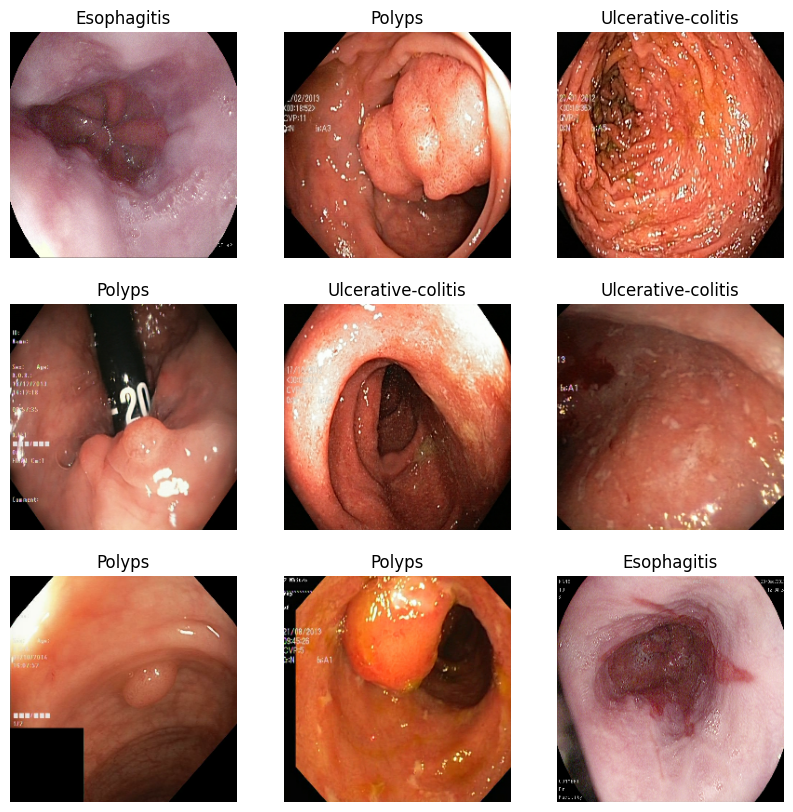

In [ ]:
import matplotlib.pyplot as plt

%matplotlib inline

plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[np.argmax(labels[i])])
    plt.axis("off")

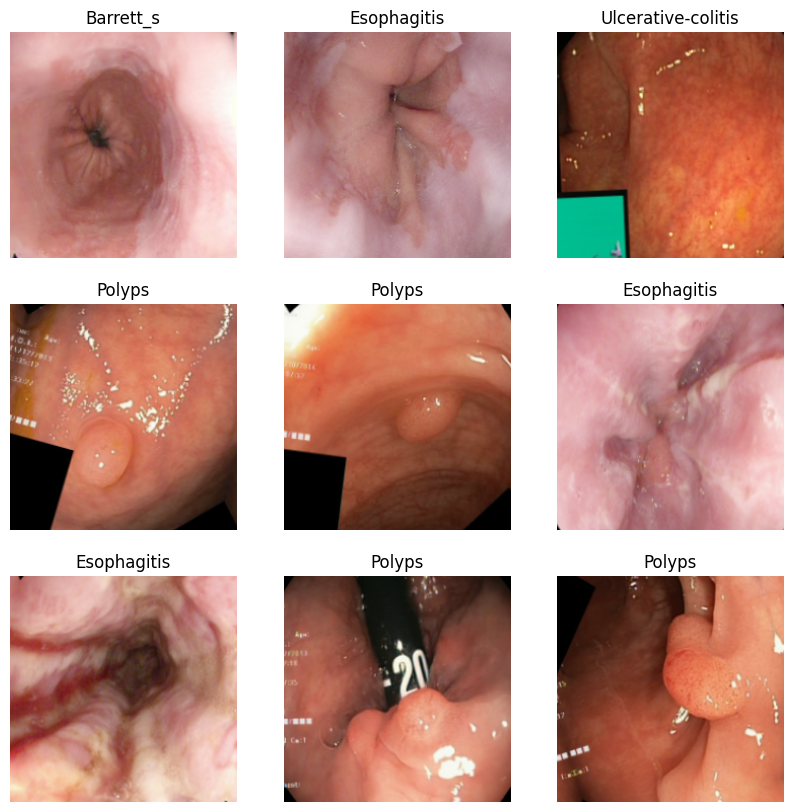

In [ ]:
import matplotlib.pyplot as plt

%matplotlib inline

plt.figure(figsize=(10, 10))
for images, labels in train_ds_aug.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[np.argmax(labels[i])])
    plt.axis("off")

In [ ]:
test_ds_aug = augument_data1 (test_ds, img_height-20)
test_ds_norm = norm_data (test_ds_aug)


In [ ]:
AUTOTUNE = tf.data.AUTOTUNE
test_ds_norm = test_ds_norm.cache().prefetch(buffer_size=AUTOTUNE)

In [ ]:
i = 0
y = np.zeros(shape=(534,5))
for inputs_batch, labels_batch in test_ds_norm:
  #print(inputs_batch.shape)
  y[i * batch_size : (i + 1) * batch_size] = labels_batch
  i += 1
  if i * batch_size >= 534:
      break

In [ ]:
y

array([[0., 1., 0., 0., 0.],
       [0., 0., 0., 1., 0.],
       [0., 1., 0., 0., 0.],
       ...,
       [1., 0., 0., 0., 0.],
       [0., 0., 0., 0., 1.],
       [0., 0., 0., 0., 1.]])

CNN

In [ ]:
from keras.models import Model
from keras.layers import Dense
from keras.layers import Flatten

from keras import layers
from keras import optimizers
from tensorflow.keras import regularizers

num_classes = 5

#Using early stopping to reduce overfitting and saving model weights
callback = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=3)
filepath="weights.best.hdf5"
checkpoint = tf.keras.callbacks.ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')

callbacks_list = [checkpoint, callback]

model1 = tf.keras.Sequential([
  layers.Conv2D(64, 3, activation='relu', input_shape=(224,224,3), padding='same',
                kernel_regularizer=regularizers.l2(1e-4)),
  layers.Conv2D(64, 3, activation='relu', padding='same',kernel_regularizer=regularizers.l2(1e-4)),
  layers.MaxPooling2D(),
  layers.Conv2D(128, 3, activation='relu',padding='same', kernel_regularizer=regularizers.l2(1e-4)),
  layers.Conv2D(128, 3, activation='relu',padding='same', kernel_regularizer=regularizers.l2(1e-4)),
  layers.MaxPooling2D(),
  layers.Conv2D(256, 3, activation='relu',padding='same', kernel_regularizer=regularizers.l2(1e-4)),
  layers.Conv2D(256, 3, activation='relu',padding='same', kernel_regularizer=regularizers.l2(1e-4)),
  layers.MaxPooling2D(),
  layers.Flatten(),
  layers.Dropout(0.4),
  layers.Dense(256, activation='relu', kernel_regularizer=regularizers.l2(1e-4)),
  layers.Dropout(0.4),
  layers.Dense(num_classes, activation='softmax', kernel_regularizer=regularizers.l2(1e-4))
])

In [ ]:
opt1=optimizers.RMSprop(learning_rate=2e-5)

In [ ]:
opt2 = tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.8)

In [ ]:
opt3=optimizers.RMSprop(learning_rate=0.001)

In [ ]:
model1.compile(
  optimizer=opt1,
  loss="categorical_crossentropy",
  metrics=['accuracy'])
     

In [ ]:
hist_cnn_m2 = model1.fit(train_ds_norm,
  epochs=20,callbacks=[callbacks_list],
  validation_data = val_ds_norm
)

Epoch 1/20
50/50 [==============================] - ETA: 0s - loss: 1.0038 - accuracy: 0.6511
Epoch 1: val_accuracy improved from -inf to 0.81641, saving model to weights.best.hdf5
50/50 [==============================] - 389s 7s/step - loss: 1.0038 - accuracy: 0.6511 - val_loss: 0.6652 - val_accuracy: 0.8164
Epoch 2/20
50/50 [==============================] - ETA: 0s - loss: 0.6475 - accuracy: 0.7946
Epoch 2: val_accuracy improved from 0.81641 to 0.83398, saving model to weights.best.hdf5
50/50 [==============================] - 17s 344ms/step - loss: 0.6475 - accuracy: 0.7946 - val_loss: 0.5619 - val_accuracy: 0.8340
Epoch 3/20
50/50 [==============================] - ETA: 0s - loss: 0.5709 - accuracy: 0.8274
Epoch 3: val_accuracy improved from 0.83398 to 0.84570, saving model to weights.best.hdf5
50/50 [==============================] - 19s 386ms/step - loss: 0.5709 - accuracy: 0.8274 - val_loss: 0.5102 - val_accuracy: 0.8457
Epoch 4/20
50/50 [==============================] - ETA: 

In [ ]:
model1.summary()

Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_90 (Conv2D)          (None, 224, 224, 64)      1792      
                                                                 
 conv2d_91 (Conv2D)          (None, 224, 224, 64)      36928     
                                                                 
 max_pooling2d_45 (MaxPoolin  (None, 112, 112, 64)     0         
 g2D)                                                            
                                                                 
 conv2d_92 (Conv2D)          (None, 112, 112, 128)     73856     
                                                                 
 conv2d_93 (Conv2D)          (None, 112, 112, 128)     147584    
                                                                 
 max_pooling2d_46 (MaxPoolin  (None, 56, 56, 128)      0         
 g2D)                                                

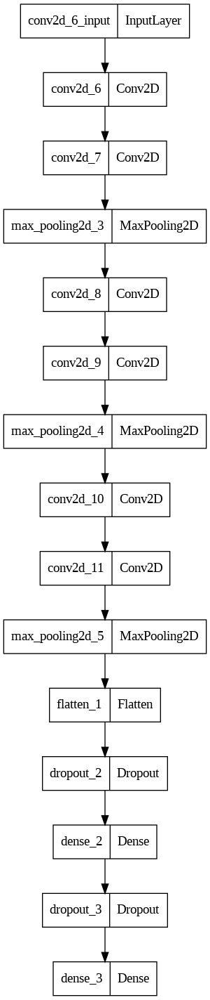

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
keras.utils.plot_model(model1, "cnn_model.png")

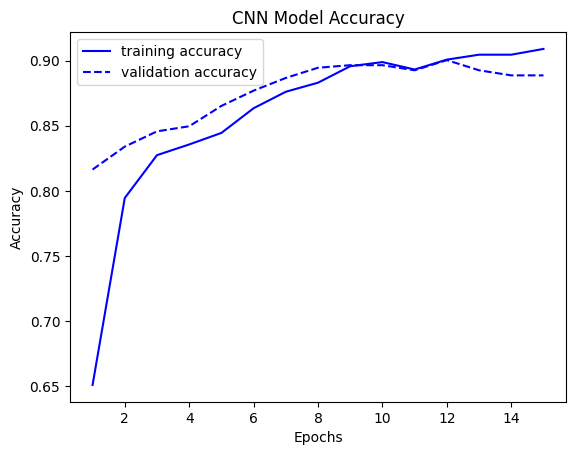

In [ ]:
import matplotlib.pyplot as plt

acc = hist_cnn_m2.history['accuracy']
val_acc = hist_cnn_m2.history['val_accuracy']
loss = hist_cnn_m2.history['loss']
val_loss = hist_cnn_m2.history['val_loss']

epochs = range(1, len(acc) + 1)

plt.title('CNN Model Accuracy')
plt.plot(epochs, acc, 'b', label='training accuracy')
plt.plot(epochs, val_acc, 'b--', label='validation accuracy')

plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.xticks(np.arange(2, len(acc)+1, 2))
plt.legend()


plt.show()

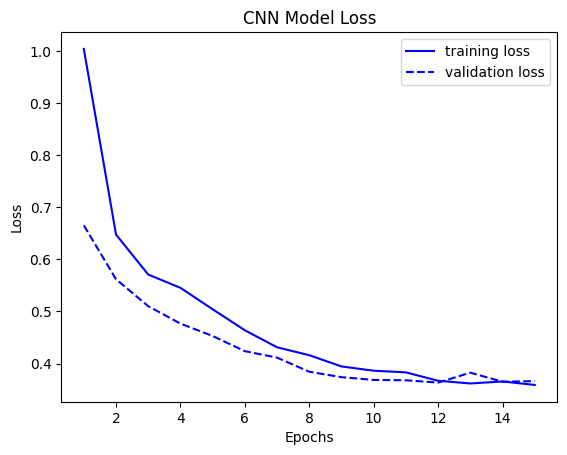

In [ ]:
plt.title('CNN Model Loss')
plt.plot(epochs, loss, 'b', label='training loss')
plt.plot(epochs, val_loss, 'b--', label='validation loss')

plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.xticks(np.arange(2, len(loss)+1, 2))
plt.legend()


plt.show()

In [ ]:
#Training on validation set
hist_cnn_m2 = model1.fit(val_ds_norm,
  epochs=10,callbacks=[callbacks_list],
  validation_data = train_ds_norm
)

Epoch 1/10
16/16 [==============================] - ETA: 0s - loss: 0.3945 - accuracy: 0.8887
Epoch 1: val_accuracy improved from 0.90039 to 0.91593, saving model to weights.best.hdf5
16/16 [==============================] - 11s 723ms/step - loss: 0.3945 - accuracy: 0.8887 - val_loss: 0.3221 - val_accuracy: 0.9159
Epoch 2/10
16/16 [==============================] - ETA: 0s - loss: 0.3599 - accuracy: 0.8984
Epoch 2: val_accuracy did not improve from 0.91593
16/16 [==============================] - 10s 629ms/step - loss: 0.3599 - accuracy: 0.8984 - val_loss: 0.3251 - val_accuracy: 0.9128
Epoch 3/10
16/16 [==============================] - ETA: 0s - loss: 0.3646 - accuracy: 0.8965
Epoch 3: val_accuracy did not improve from 0.91593
16/16 [==============================] - 9s 552ms/step - loss: 0.3646 - accuracy: 0.8965 - val_loss: 0.3244 - val_accuracy: 0.9153
Epoch 4/10
16/16 [==============================] - ETA: 0s - loss: 0.3442 - accuracy: 0.9082
Epoch 4: val_accuracy did not improve

In [ ]:
model1.evaluate(test_ds_norm)

17/17 [==============================] - 18s 226ms/step - loss: 0.3734 - accuracy: 0.8951


[0.3733995258808136, 0.8951311111450195]

In [ ]:
test_pred = model1.predict(test_ds_norm)

17/17 [==============================] - 1s 77ms/step


In [ ]:
from sklearn.metrics import classification_report
print(classification_report(np.argmax(y[:], axis=1), np.argmax(test_pred[:], axis=1)))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        20
           1       0.85      1.00      0.92       134
           2       0.00      0.00      0.00         2
           3       0.94      0.89      0.92       207
           4       0.88      0.93      0.90       171

    accuracy                           0.90       534
   macro avg       0.54      0.56      0.55       534
weighted avg       0.86      0.90      0.88       534



/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
def cm_plt(ax, cm, classes, cmap, title, normalize):

    im = ax.imshow(cm, interpolation="nearest", cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    ax.set(
        xticks=np.arange(cm.shape[1]),
        yticks=np.arange(cm.shape[0]),
        xticklabels=classes,
        yticklabels=classes,
        title=title,
        ylabel="True label",
        xlabel="Predicted label",
    )

    plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")

    fmt = ".2f" if normalize else "d"
    thresh = cm.max() / 2.0
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(
                j,
                i,
                format(cm[i, j], fmt),
                ha="center",
                va="center",
                color="white" if cm[i, j] > thresh else "black",
            )

    return ax


# Defining function for confusion matrix plot
def plt_confusion_mat(cm, classes, fig_size, cmap=plt.cm.BuPu):
   
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=fig_size)
    ax1 = cm_plt(
        ax1,
        cm,
        classes,
        cmap,
        title="Confusion matrix, without normalization",
        normalize=False,
    )

    cmn = cm.astype("float") / cm.sum(axis=1)[:, np.newaxis]
    ax2 = cm_plt(
        ax2,
        cmn,
        classes,
        cmap,
        title="Normalized confusion matrix",
        normalize=True,
    )

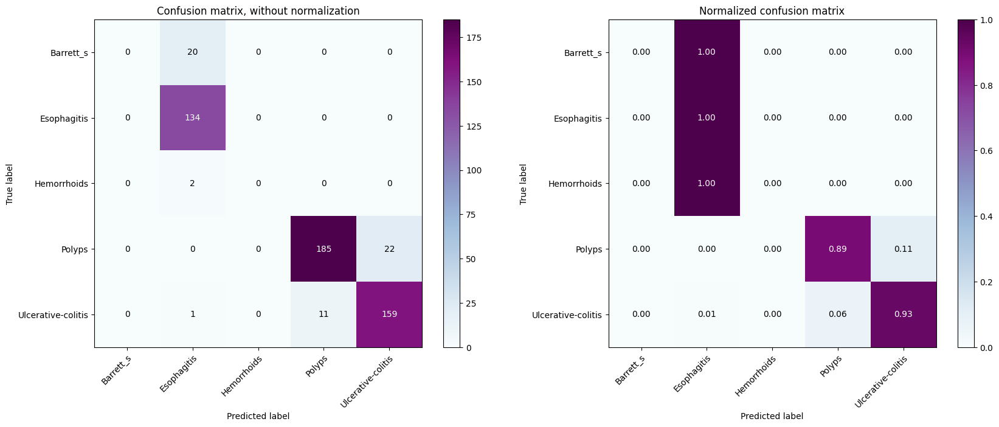

In [ ]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(np.argmax(y, axis=1), np.argmax(test_pred, axis=1))
plt_confusion_mat(cm, classes=categories, fig_size=(20, 7))

1/1 [==============================] - 0s 302ms/step


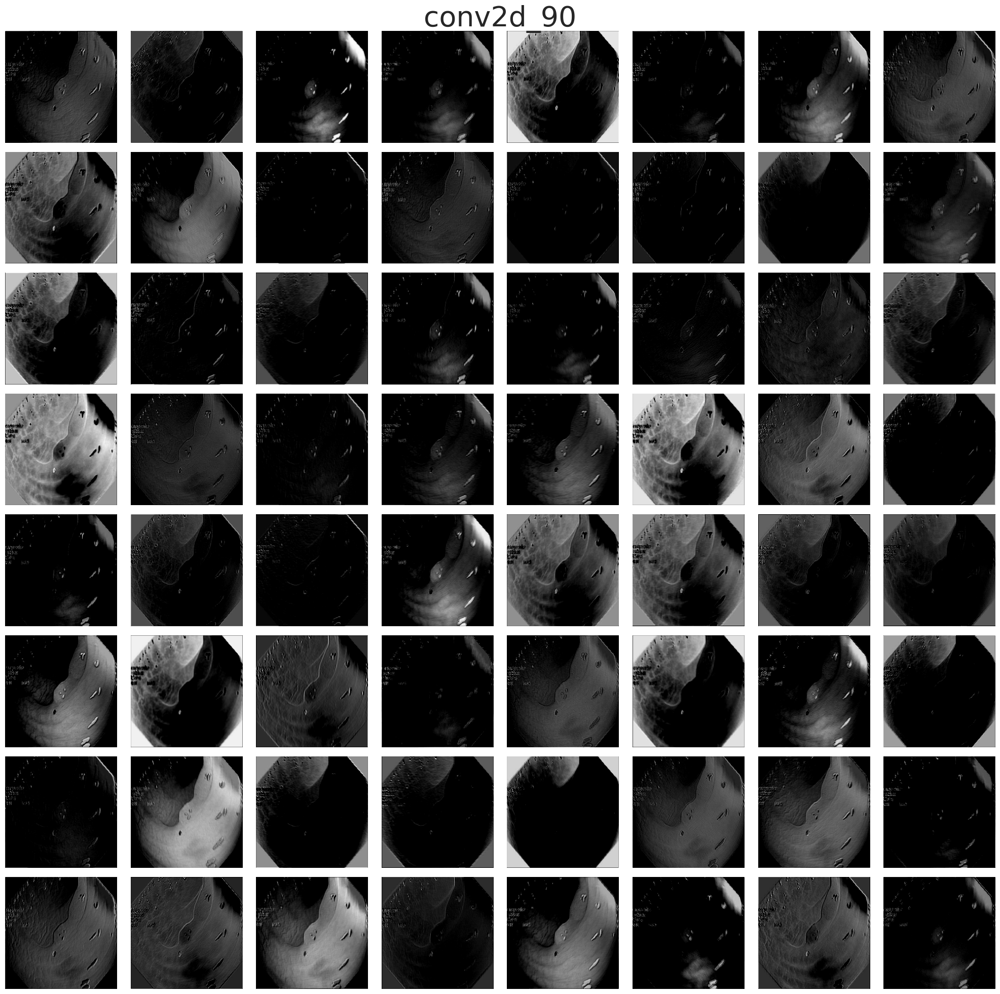

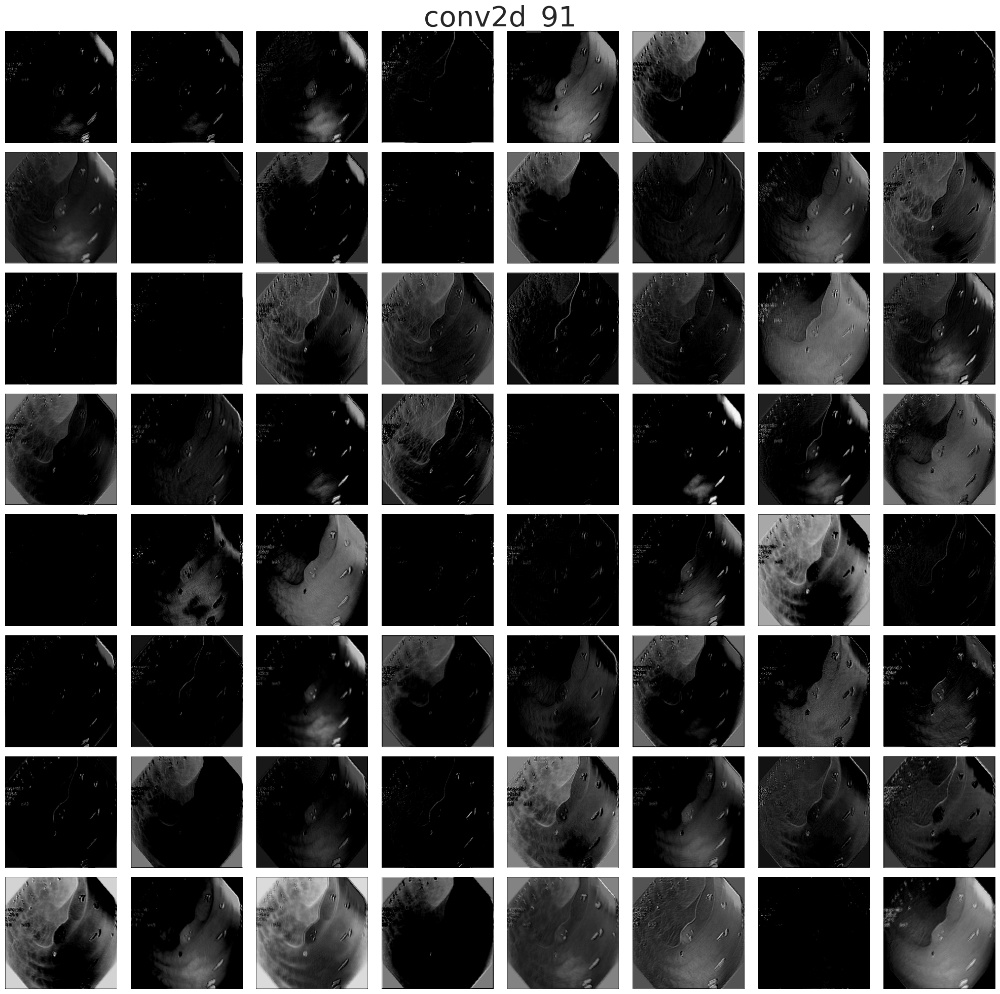

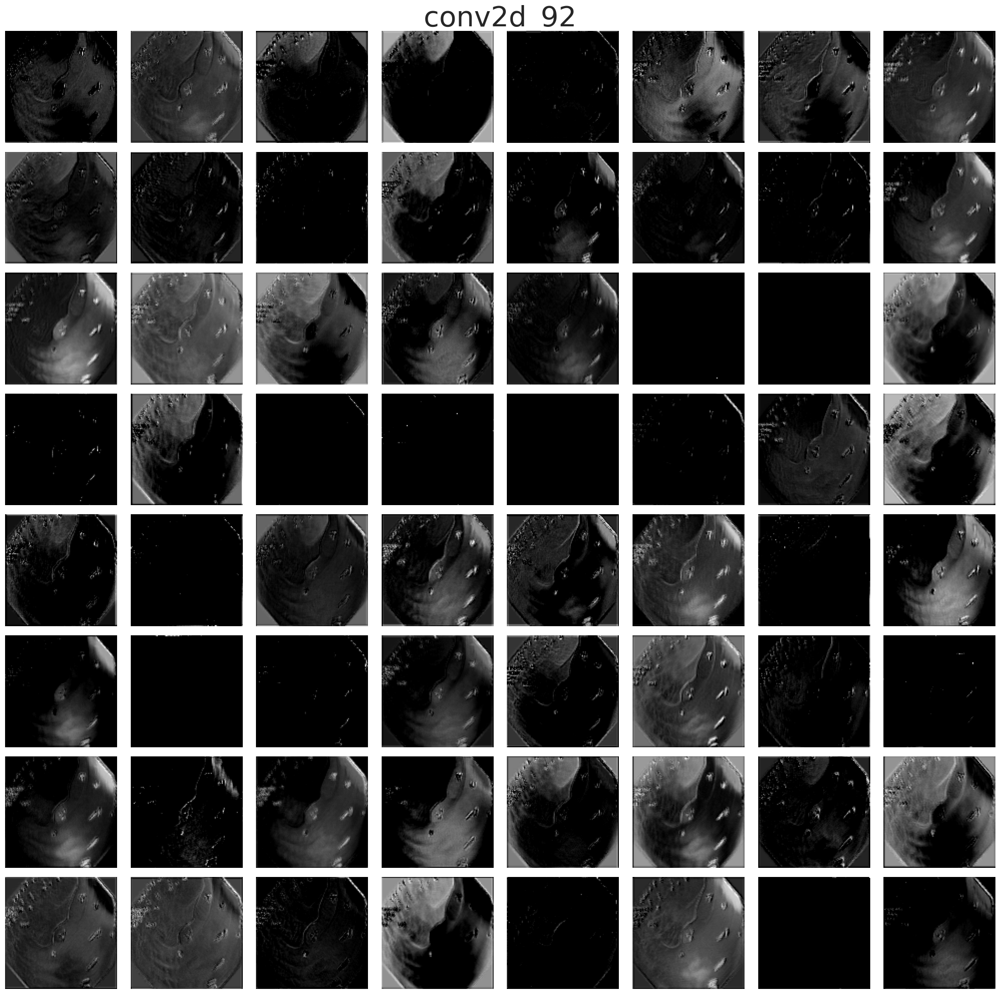

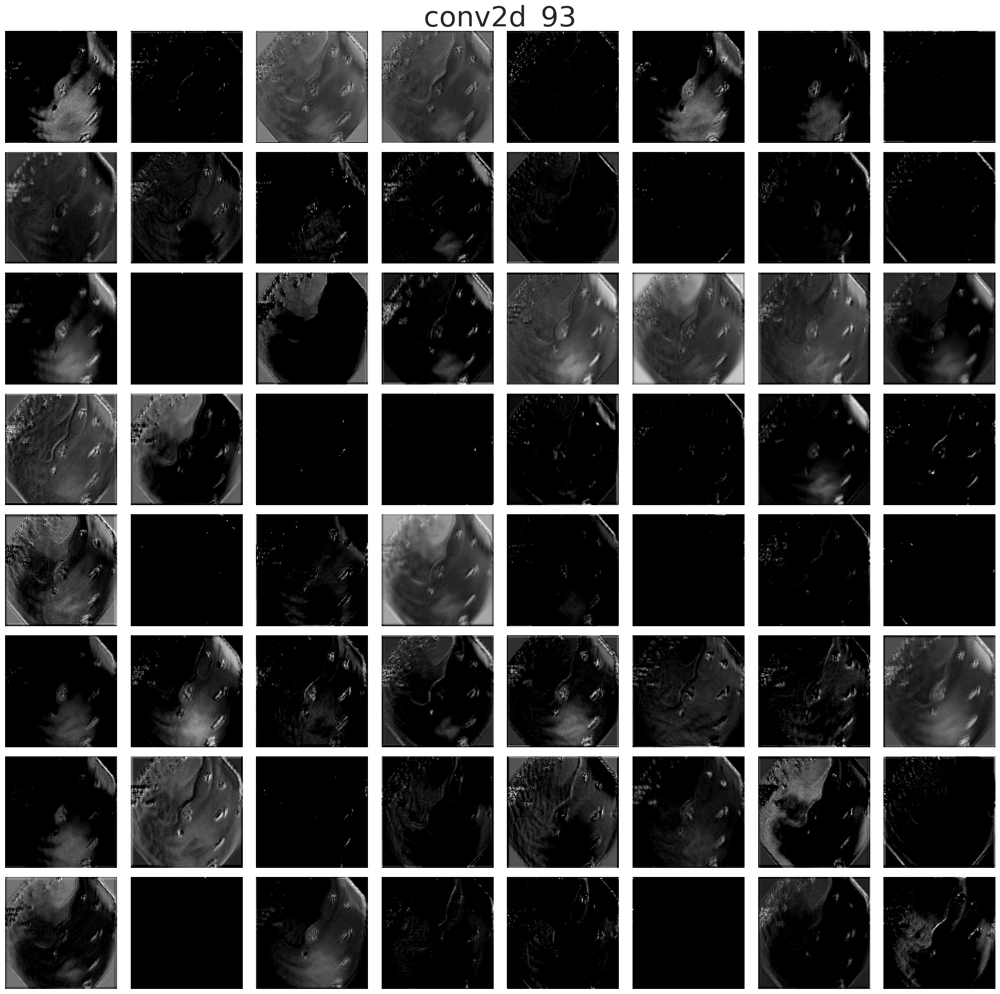

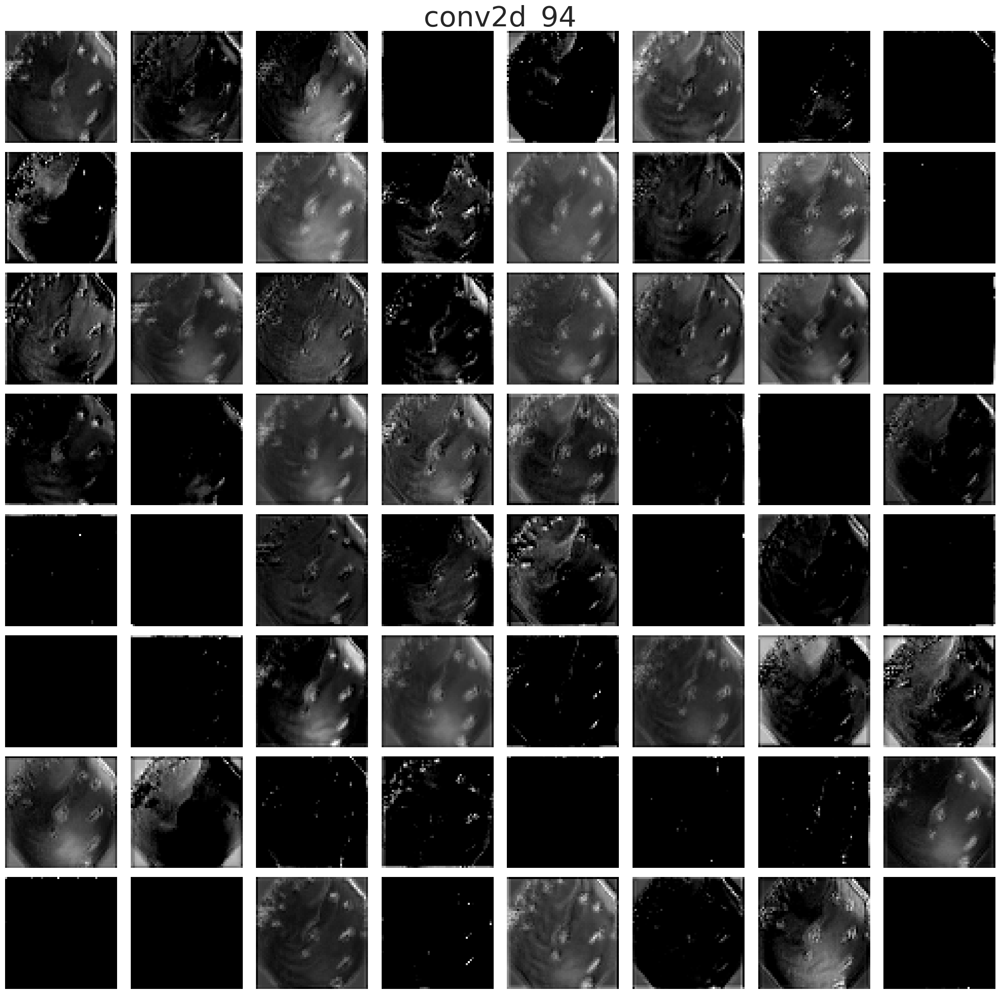

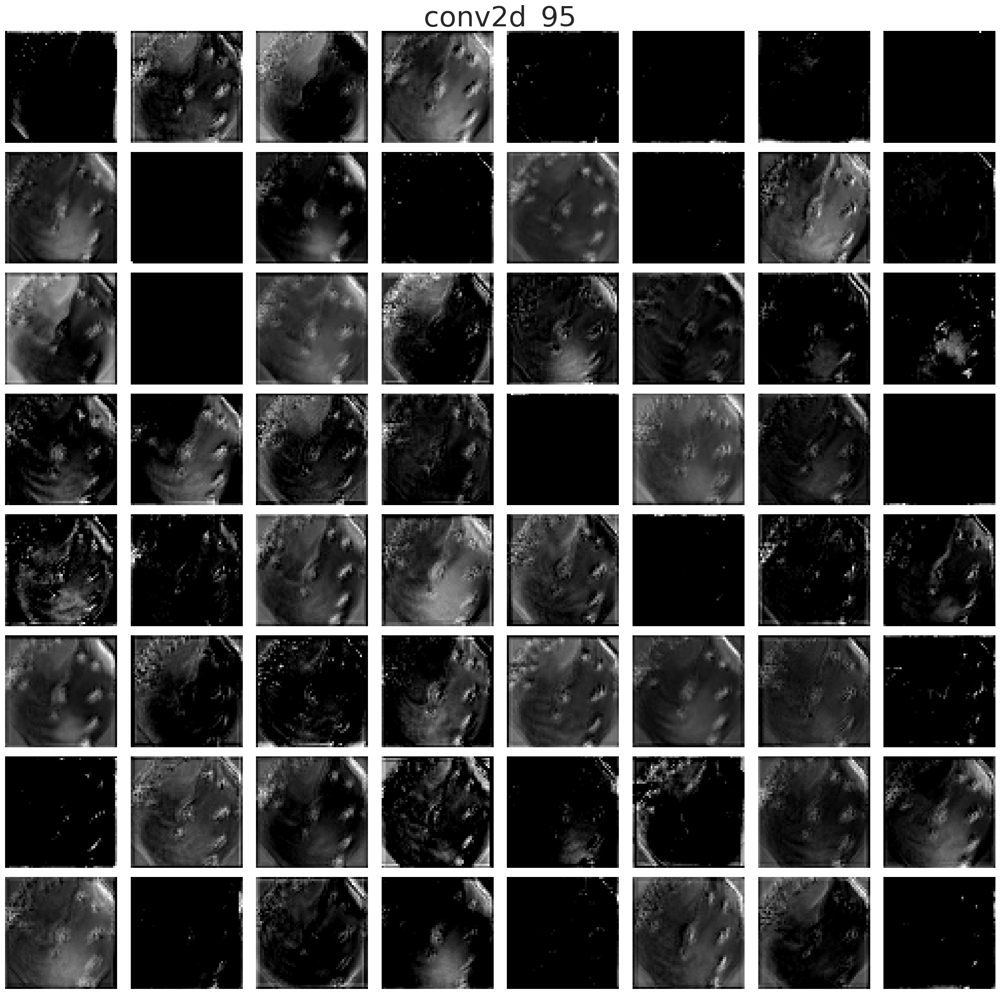

In [ ]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg16 import preprocess_input, decode_predictions


# Choose an image to visualize the feature maps
img_path = '/content/labeled-images/lower-gi-tract/pathological-findings/polyps/0004a718-546c-41c2-9c69-c4685093a039.jpg'
img = image.load_img(img_path, target_size=(224, 224))
x = image.img_to_array(img)
x = np.expand_dims(x, axis=0)
x = preprocess_input(x)

# Define the layers to visualize
layer_names = ['conv2d_90', 'conv2d_91', 'conv2d_92', 'conv2d_93', 'conv2d_94','conv2d_95']

# Create a model that outputs the feature maps of the chosen layers
outputs = [model1.get_layer(name).output for name in layer_names]
vis_model = tf.keras.models.Model(inputs=model1.input, outputs=outputs)

# Get the feature maps of the chosen layers for the input image
feature_maps = vis_model.predict(x)

# Visualize the feature maps
for i, fmap in enumerate(feature_maps):
    plt.figure(figsize=(20, 20))
    plt.suptitle(layer_names[i], fontsize=40)
    num_fmaps = fmap.shape[-1]
    if num_fmaps > 64:
        num_fmaps = 64
        fmap = fmap[:, :, :, :num_fmaps]
    for j in range(num_fmaps):
        plt.subplot(8, 8, j+1)
        plt.imshow(fmap[0, :, :, j], cmap='gray')
        plt.axis('off')
    plt.tight_layout()
    plt.show()

In [ ]:
from keras.models import Model
from keras.layers import Dense
from keras.layers import Flatten

from keras import layers
from keras import optimizers
from tensorflow.keras import regularizers
     

In [ ]:
#Defining a general CNN model 
def get_model(num_classes = 5, drop_out=0.4, reg=None, n_densenodes=256):

  model = tf.keras.Sequential()
  model.add(layers.Conv2D(64, 3, activation='relu', input_shape=(224,224,3), padding='same',
                kernel_regularizer=reg))
  model.add(layers.Conv2D(64, 3, activation='relu', padding='same',
                kernel_regularizer=reg))

  model.add(layers.MaxPooling2D())

  model.add(layers.Conv2D(128, 3, activation='relu',padding='same'))
  model.add(layers.Conv2D(128, 3, activation='relu',padding='same'))
  
  model.add(layers.MaxPooling2D())

  model.add(layers.Conv2D(256, 3, activation='relu',padding='same'))
  model.add(layers.Conv2D(256, 3, activation='relu',padding='same'))
  model.add(layers.MaxPooling2D())
  model.add(layers.Flatten())
  model.add(layers.Dropout(drop_out))

  model.add(layers.Dense(n_densenodes, activation='relu', kernel_regularizer=reg))
  model.add(layers.Dropout(drop_out))
  model.add(layers.Dense(num_classes, activation='softmax', kernel_regularizer=reg))
  
  return model

In [ ]:
#Using various optimizers, learning rates and momentum to find the best fit for the CNN model
def optimizer_search(iters=10):
  
  opt1 = optimizers.RMSprop(learning_rate=2e-5)
  opt2 = optimizers.RMSprop(learning_rate=2e-4)
  opt3 = optimizers.SGD(learning_rate=0.001, momentum=0.8)
  opt3 = optimizers.SGD(learning_rate=0.001, momentum=0.8)
  opt3 = optimizers.SGD(learning_rate=0.001, momentum=0.8)
  opt4 = optimizers.SGD(learning_rate=0.001, momentum=0.9)
  opt5 = optimizers.SGD(learning_rate=0.01, momentum=0.8)
  opt6 = optimizers.SGD(learning_rate=0.01, momentum=0.9)
  opt7 = optimizers.SGD(learning_rate=0.0001, momentum=0.8)
  opt8 = optimizers.SGD(learning_rate=0.0001, momentum=0.9)
  opt9 = optimizers.Adam()

  opt_list = [opt1, opt2, opt3, opt4, opt5, opt6, opt7, opt8, opt9]
  opt_name = ['RMSprop(learning_rate=2e-5)', 
              'RMSprop(learning_rate=2e-4)', 
              'SGD(learning_rate=0.001, momentum=0.8)',
              'SGD(learning_rate=0.001, momentum=0.9)',
              'SGD(learning_rate=0.01, momentum=0.8)',
              'SGD(learning_rate=0.01, momentum=0.9)',
              'SGD(learning_rate=0.0001, momentum=0.8)',
              'SGD(learning_rate=0.0001, momentum=0.9)',
              'adam']
  opt_hist=[]
  
  for i, opt in enumerate(opt_list):
    print(opt_name[i])
    model = get_model()
    model.compile(optimizer=opt, loss="categorical_crossentropy", metrics=['accuracy'])
    h = model.fit(train_ds_norm, epochs=15, validation_data = val_ds_norm)
    opt_hist.append(h)
    print("")
  
  return opt_hist, opt_name

In [ ]:
opt_hist = optimizer_search()

RMSprop(learning_rate=2e-5)
Epoch 1/15
50/50 [==============================] - 16s 310ms/step - loss: 0.8867 - accuracy: 0.6612 - val_loss: 0.5326 - val_accuracy: 0.8398
Epoch 2/15
50/50 [==============================] - 15s 305ms/step - loss: 0.5211 - accuracy: 0.7990 - val_loss: 0.4530 - val_accuracy: 0.8184
Epoch 3/15
50/50 [==============================] - 15s 302ms/step - loss: 0.4537 - accuracy: 0.8306 - val_loss: 0.3889 - val_accuracy: 0.8535
Epoch 4/15
50/50 [==============================] - 15s 306ms/step - loss: 0.4090 - accuracy: 0.8445 - val_loss: 0.3651 - val_accuracy: 0.8555
Epoch 5/15
50/50 [==============================] - 15s 308ms/step - loss: 0.3723 - accuracy: 0.8584 - val_loss: 0.3245 - val_accuracy: 0.8750
Epoch 6/15
50/50 [==============================] - 16s 315ms/step - loss: 0.3384 - accuracy: 0.8767 - val_loss: 0.3164 - val_accuracy: 0.8828
Epoch 7/15
50/50 [==============================] - 15s 305ms/step - loss: 0.3260 - accuracy: 0.8869 - val_loss: 0

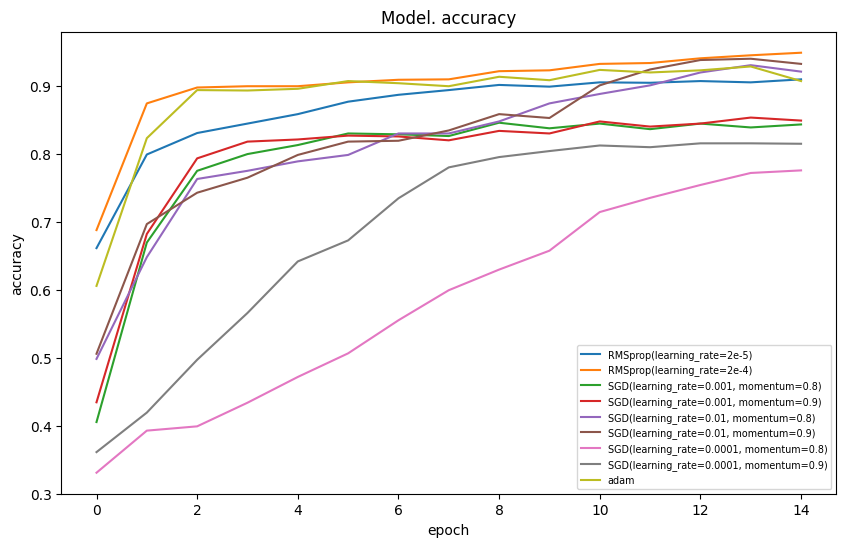

In [ ]:
plt.figure(figsize=(10, 6))  



plt.plot(opt_hist[0][0].history['accuracy'])
plt.plot(opt_hist[0][1].history['accuracy'])
plt.plot(opt_hist[0][2].history['accuracy'])
plt.plot(opt_hist[0][3].history['accuracy'])
plt.plot(opt_hist[0][4].history['accuracy'])
plt.plot(opt_hist[0][5].history['accuracy'])
plt.plot(opt_hist[0][6].history['accuracy'])
plt.plot(opt_hist[0][7].history['accuracy'])
plt.plot(opt_hist[0][8].history['accuracy'])


plt.title('Model. accuracy')  
plt.ylabel('accuracy')  
plt.xlabel('epoch')  
plt.legend([opt_hist[1][0],opt_hist[1][1],opt_hist[1][2],opt_hist[1][3],opt_hist[1][4],opt_hist[1][5],opt_hist[1][6],opt_hist[1][7],opt_hist[1][8]], loc='best', fontsize = 'x-small')  

plt.show()

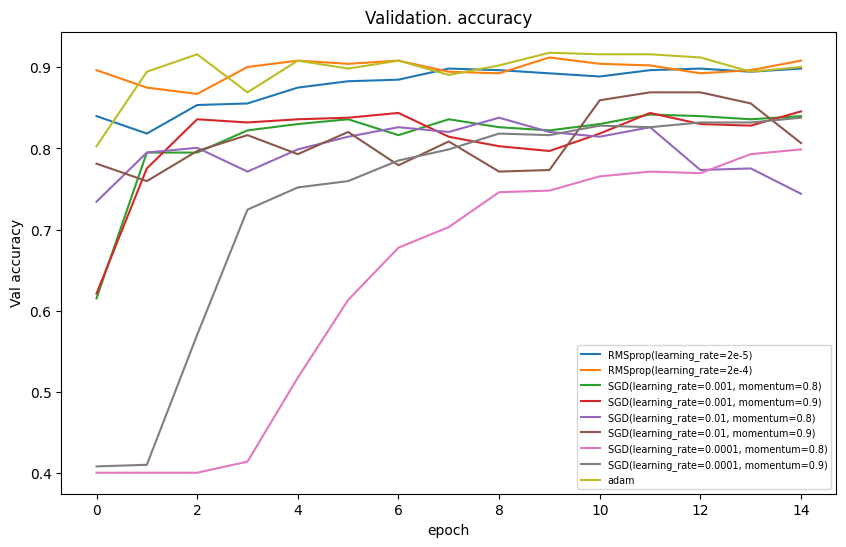

In [ ]:
plt.figure(figsize=(10, 6))  

plt.plot(opt_hist[0][0].history['val_accuracy'])
plt.plot(opt_hist[0][1].history['val_accuracy'])
plt.plot(opt_hist[0][2].history['val_accuracy'])
plt.plot(opt_hist[0][3].history['val_accuracy'])
plt.plot(opt_hist[0][4].history['val_accuracy'])
plt.plot(opt_hist[0][5].history['val_accuracy'])
plt.plot(opt_hist[0][6].history['val_accuracy'])
plt.plot(opt_hist[0][7].history['val_accuracy'])
plt.plot(opt_hist[0][8].history['val_accuracy'])

plt.title('Validation. accuracy')  
plt.ylabel('Val accuracy')  
plt.xlabel('epoch')  
plt.legend([opt_hist[1][0],opt_hist[1][1],opt_hist[1][2],opt_hist[1][3],opt_hist[1][4],opt_hist[1][5],opt_hist[1][6],opt_hist[1][7],opt_hist[1][8]], loc='best', fontsize = 'x-small')  

plt.show()


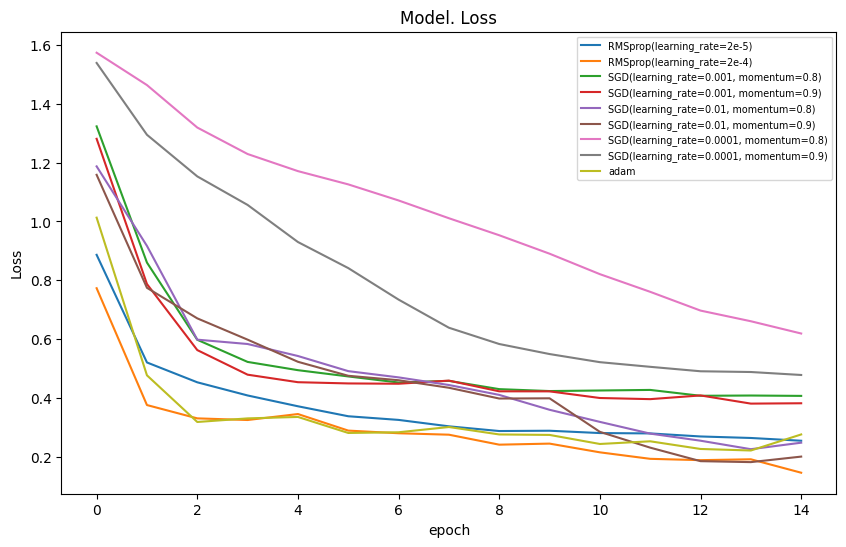

In [ ]:
plt.figure(figsize=(10, 6))  


plt.plot(opt_hist[0][0].history['loss'])
plt.plot(opt_hist[0][1].history['loss'])
plt.plot(opt_hist[0][2].history['loss'])
plt.plot(opt_hist[0][3].history['loss'])
plt.plot(opt_hist[0][4].history['loss'])
plt.plot(opt_hist[0][5].history['loss'])
plt.plot(opt_hist[0][6].history['loss'])
plt.plot(opt_hist[0][7].history['loss'])
plt.plot(opt_hist[0][8].history['loss'])

plt.title('Model. Loss')  
plt.ylabel('Loss')  
plt.xlabel('epoch')  
plt.legend([opt_hist[1][0],opt_hist[1][1],opt_hist[1][2],opt_hist[1][3],opt_hist[1][4],opt_hist[1][5],opt_hist[1][6],opt_hist[1][7],opt_hist[1][8]], loc='best', fontsize = 'x-small')  

plt.show()


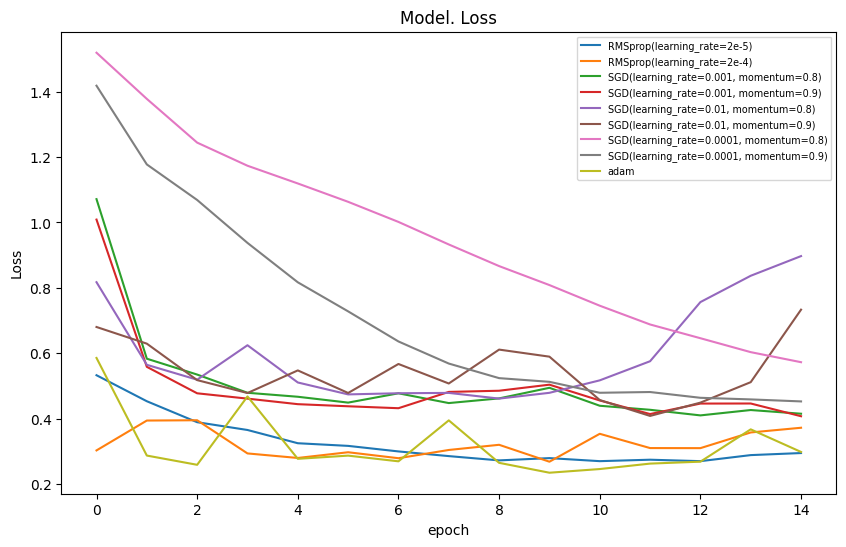

In [ ]:
plt.figure(figsize=(10, 6))  



plt.plot(opt_hist[0][0].history['val_loss'])
plt.plot(opt_hist[0][1].history['val_loss'])
plt.plot(opt_hist[0][2].history['val_loss'])
plt.plot(opt_hist[0][3].history['val_loss'])
plt.plot(opt_hist[0][4].history['val_loss'])
plt.plot(opt_hist[0][5].history['val_loss'])
plt.plot(opt_hist[0][6].history['val_loss'])
plt.plot(opt_hist[0][7].history['val_loss'])
plt.plot(opt_hist[0][8].history['val_loss'])

plt.title('Model. Loss')  
plt.ylabel('Loss')  
plt.xlabel('epoch')  
plt.legend([opt_hist[1][0],opt_hist[1][1],opt_hist[1][2],opt_hist[1][3],opt_hist[1][4],opt_hist[1][5],opt_hist[1][6],opt_hist[1][7],opt_hist[1][8]], loc='best', fontsize = 'x-small')  

plt.show()


In [ ]:
def reguralizer_search(iters=10):
  
  opt3 = optimizers.SGD(learning_rate=0.001, momentum=0.8)
  reg1 = regularizers.l2(1e-4)
  reg2 = regularizers.l1(1e-5)
  reg3 = regularizers.l2(1e-5)
  reg4 = regularizers.l2(1e-3)

  reg_list = [reg1, reg2, reg3, reg4]
  reg_name = ['regularizers.l2(1e-4)', 
              'regularizers.l1(1e-5)', 
              'regularizers.l2(1e-5)',
              'regularizers.l2(1e-3)']
  reg_hist=[]

  # regularizers.l2(1e-4)

  # 2. pick regularizer
  for i, r in enumerate(reg_list):
    print(reg_name[i])
    model = get_model(reg=r)
    model.compile(optimizer=opt3, loss="categorical_crossentropy", metrics=['accuracy'])
    h = model.fit(train_ds_norm, epochs=15, validation_data = val_ds_norm,callbacks=[callbacks_list])
    reg_hist.append(h)
    print("")
  
  return reg_hist, reg_name


In [ ]:
reg_hist = reguralizer_search()

regularizers.l2(1e-4)
Epoch 1/15
50/50 [==============================] - ETA: 0s - loss: 1.3790 - accuracy: 0.3951
Epoch 1: val_accuracy did not improve from 0.91593
50/50 [==============================] - 16s 300ms/step - loss: 1.3790 - accuracy: 0.3951 - val_loss: 1.1470 - val_accuracy: 0.5762
Epoch 2/15
50/50 [==============================] - ETA: 0s - loss: 1.0594 - accuracy: 0.5771
Epoch 2: val_accuracy did not improve from 0.91593
50/50 [==============================] - 15s 298ms/step - loss: 1.0594 - accuracy: 0.5771 - val_loss: 0.8581 - val_accuracy: 0.6973
Epoch 3/15
50/50 [==============================] - ETA: 0s - loss: 0.7994 - accuracy: 0.7118
Epoch 3: val_accuracy did not improve from 0.91593
50/50 [==============================] - 15s 299ms/step - loss: 0.7994 - accuracy: 0.7118 - val_loss: 0.6055 - val_accuracy: 0.7773
Epoch 4/15
50/50 [==============================] - ETA: 0s - loss: 0.6537 - accuracy: 0.7686
Epoch 4: val_accuracy did not improve from 0.91593
50

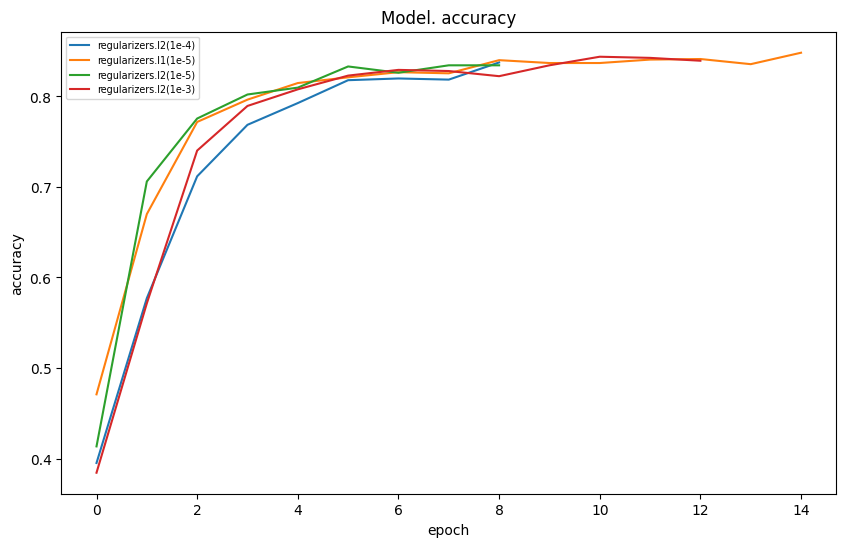

In [ ]:
plt.figure(figsize=(10, 6))  



plt.plot(reg_hist[0][0].history['accuracy'])
plt.plot(reg_hist[0][1].history['accuracy'])
plt.plot(reg_hist[0][2].history['accuracy'])
plt.plot(reg_hist[0][3].history['accuracy'])



plt.title('Model. accuracy')  
plt.ylabel('accuracy')  
plt.xlabel('epoch')  
plt.legend([reg_hist[1][0],reg_hist[1][1],reg_hist[1][2],reg_hist[1][3]], loc='best', fontsize = 'x-small')  

plt.show()

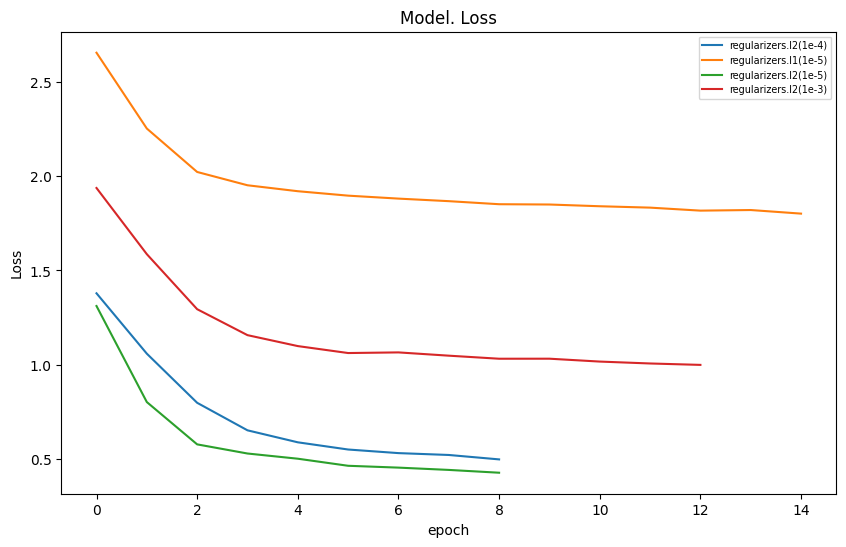

In [ ]:
plt.figure(figsize=(10, 6))  



plt.plot(reg_hist[0][0].history['loss'])
plt.plot(reg_hist[0][1].history['loss'])
plt.plot(reg_hist[0][2].history['loss'])
plt.plot(reg_hist[0][3].history['loss'])



plt.title('Model. Loss')  
plt.ylabel('Loss')  
plt.xlabel('epoch')  
plt.legend([reg_hist[1][0],reg_hist[1][1],reg_hist[1][2],reg_hist[1][3]], loc='best', fontsize = 'x-small')  

plt.show()


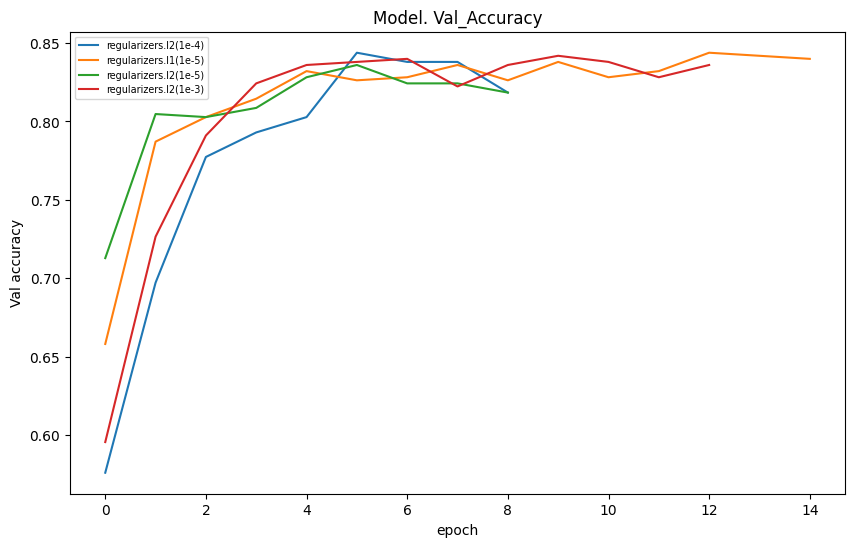

In [ ]:
plt.figure(figsize=(10, 6))  



plt.plot(reg_hist[0][0].history['val_accuracy'])
plt.plot(reg_hist[0][1].history['val_accuracy'])
plt.plot(reg_hist[0][2].history['val_accuracy'])
plt.plot(reg_hist[0][3].history['val_accuracy'])



plt.title('Model. Val_Accuracy')  
plt.ylabel('Val accuracy')  
plt.xlabel('epoch')  
plt.legend([reg_hist[1][0],reg_hist[1][1],reg_hist[1][2],reg_hist[1][3]], loc='best', fontsize = 'x-small')  

plt.show()

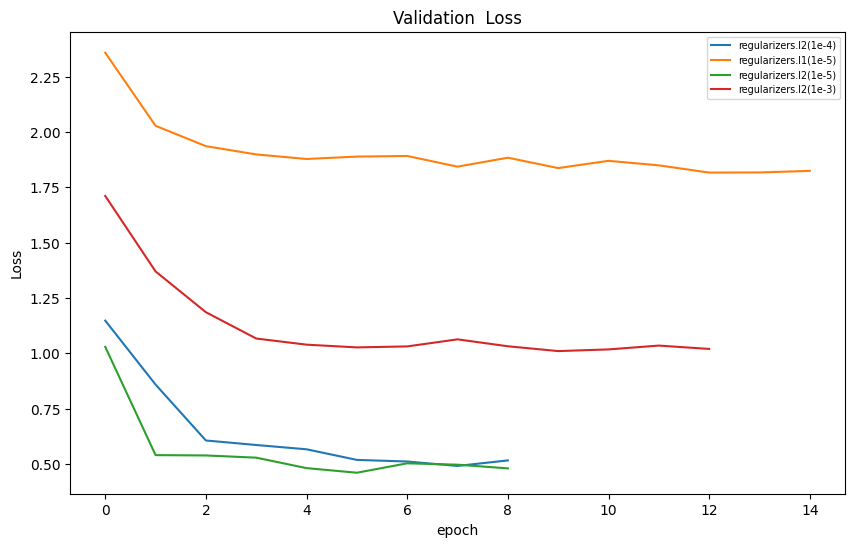

In [ ]:
plt.figure(figsize=(10, 6))  



plt.plot(reg_hist[0][0].history['val_loss'])
plt.plot(reg_hist[0][1].history['val_loss'])
plt.plot(reg_hist[0][2].history['val_loss'])
plt.plot(reg_hist[0][3].history['val_loss'])



plt.title('Validation  Loss')  
plt.ylabel('Loss')  
plt.xlabel('epoch')  
plt.legend([reg_hist[1][0],reg_hist[1][1],reg_hist[1][2],reg_hist[1][3]], loc='best', fontsize = 'x-small')  

plt.show()

VGG16

In [ ]:
from keras.applications.vgg16 import VGG16
from keras.models import Model
from keras.layers import Dense
from keras.layers import Flatten

from keras import layers
from keras import optimizers
from tensorflow.keras import regularizers

In [ ]:
model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
# add new classifier layers

flat = Flatten()(model.layers[-1].output)
drop1 = layers.Dropout(0.4)(flat)
class1 = Dense(512, activation='relu', kernel_regularizer=regularizers.l2(1e-4))(drop1)
drop2 = layers.Dropout(0.4)(class1)
class2 = Dense(256, activation='relu', kernel_regularizer=regularizers.l2(1e-4))(drop2)
drop3 = layers.Dropout(0.4)(class2)
class3 = Dense(128, activation='relu', kernel_regularizer=regularizers.l2(1e-4))(drop3)
drop4 = layers.Dropout(0.4)(class3)
class4 = Dense(64, activation='relu', kernel_regularizer=regularizers.l2(1e-4))(drop4)
drop5 = layers.Dropout(0.4)(class4)
output = Dense(5, activation='softmax', kernel_regularizer=regularizers.l2(1e-4))(drop5)
# define new model
model = Model(inputs=model.inputs, outputs=output)
# summarize
model.summary()

Model: "model_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_9 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

In [ ]:
opt1 = optimizers.SGD(learning_rate=0.01, momentum=0.8)
opt2 = optimizers.RMSprop(learning_rate=2e-5)
opt3="adam"   

In [ ]:
model.compile(
  optimizer=opt2,
  loss="categorical_crossentropy",
  metrics=['accuracy'])

In [ ]:
history1 = model.fit(
  train_ds_norm,
  epochs=20,
  validation_data = val_ds_norm
)

Epoch 1/20
50/50 [==============================] - 25s 470ms/step - loss: 1.6793 - accuracy: 0.3382 - val_loss: 1.4848 - val_accuracy: 0.5898
Epoch 2/20
50/50 [==============================] - 23s 459ms/step - loss: 1.4890 - accuracy: 0.3957 - val_loss: 1.0919 - val_accuracy: 0.6328
Epoch 3/20
50/50 [==============================] - 22s 450ms/step - loss: 1.2918 - accuracy: 0.4975 - val_loss: 0.9680 - val_accuracy: 0.6680
Epoch 4/20
50/50 [==============================] - 23s 454ms/step - loss: 1.1610 - accuracy: 0.5664 - val_loss: 0.8134 - val_accuracy: 0.8691
Epoch 5/20
50/50 [==============================] - 23s 459ms/step - loss: 1.0133 - accuracy: 0.6523 - val_loss: 0.6400 - val_accuracy: 0.8828
Epoch 6/20
50/50 [==============================] - 23s 469ms/step - loss: 0.8854 - accuracy: 0.7244 - val_loss: 0.4702 - val_accuracy: 0.9023
Epoch 7/20
50/50 [==============================] - 23s 453ms/step - loss: 0.7969 - accuracy: 0.7674 - val_loss: 0.4754 - val_accuracy: 0.9043

In [ ]:
model.save("vgg16.h5")

In [ ]:
from keras.models import load_model
model_vgg = load_model('vgg16.h5')

In [ ]:
model_vgg.layers

In [ ]:
model_vgg.summary()

Model: "model_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_9 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

In [ ]:
vgg_features_model = Model (model_vgg.layers[0].input,  model_vgg.layers[21].output)

In [ ]:
vgg_features_model.summary()

Model: "model_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_9 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

In [ ]:
model_vgg.evaluate(test_ds_norm)

17/17 [==============================] - 2s 125ms/step - loss: 0.3329 - accuracy: 0.9382


[0.33286145329475403, 0.9382022619247437]

In [ ]:
predict_test = model_vgg.predict(test_ds_norm)

17/17 [==============================] - 2s 121ms/step


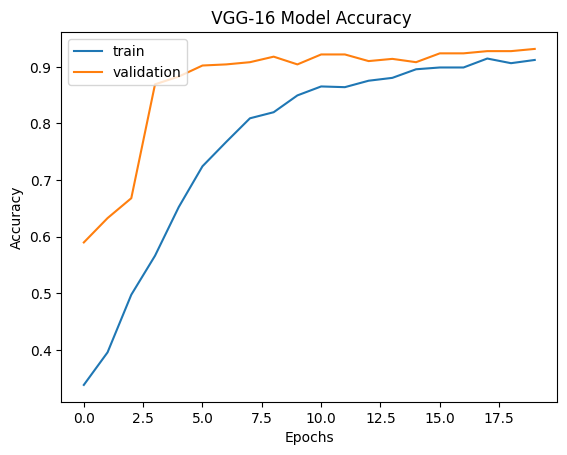

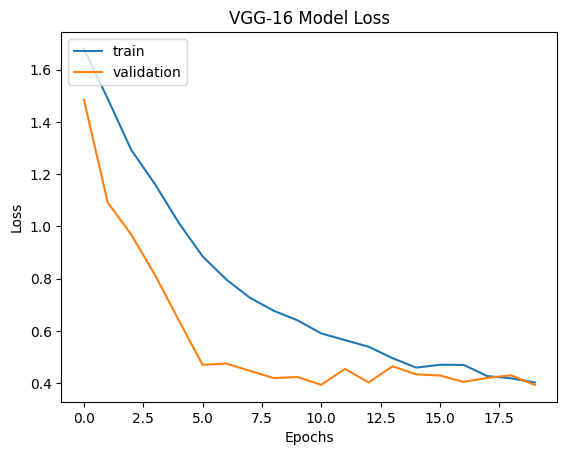

In [ ]:
import matplotlib.pyplot as plt

# Plotting accuracy graph
plt.plot(history1.history['accuracy'])
plt.plot(history1.history['val_accuracy'])
plt.title(' VGG-16 Model Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

# Plotting loss graph
plt.plot(history1.history['loss'])
plt.plot(history1.history['val_loss'])
plt.title('VGG-16 Model Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

1/1 [==============================] - 0s 119ms/step


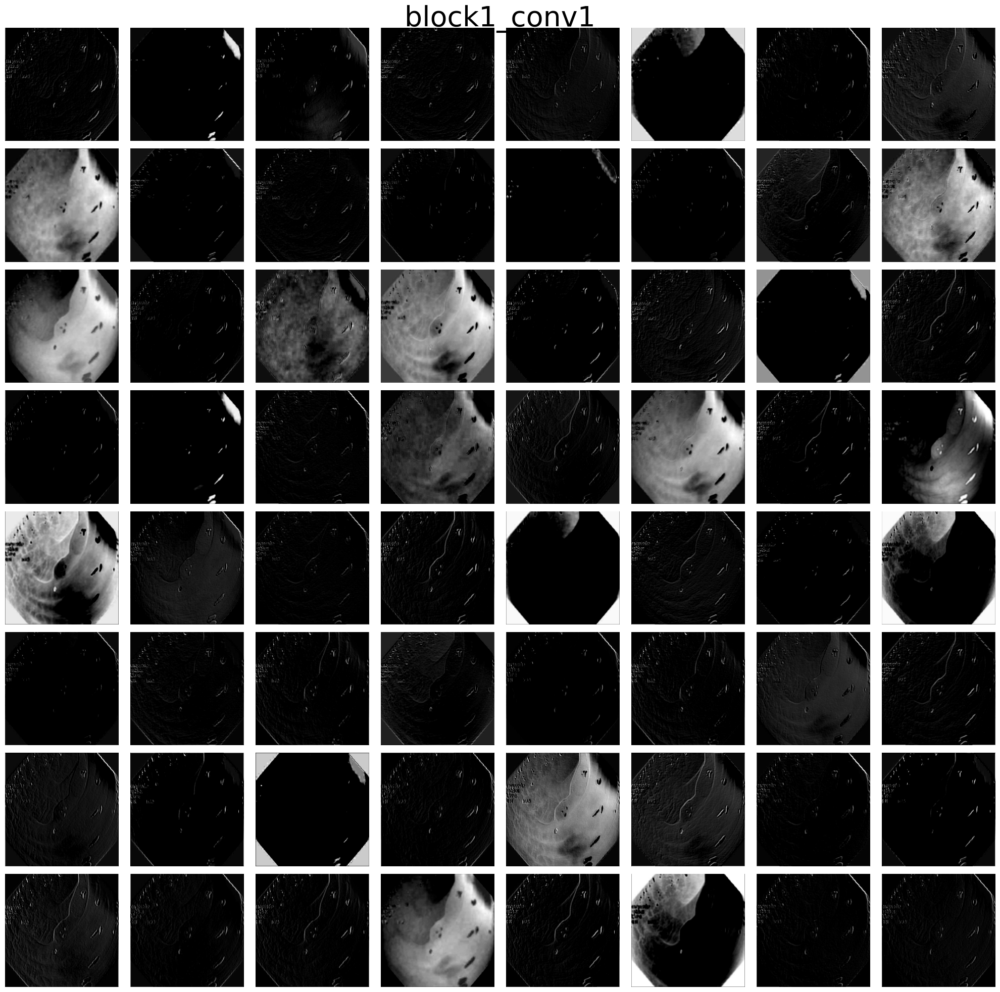

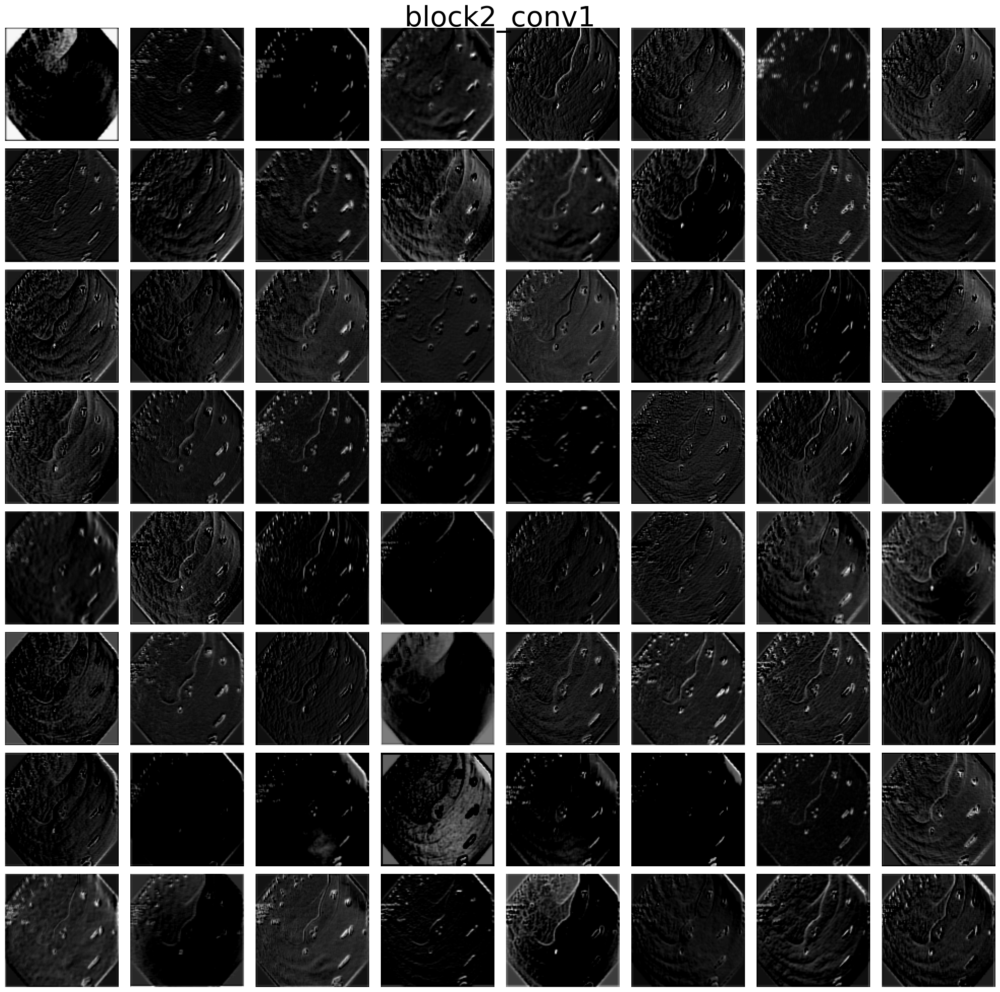

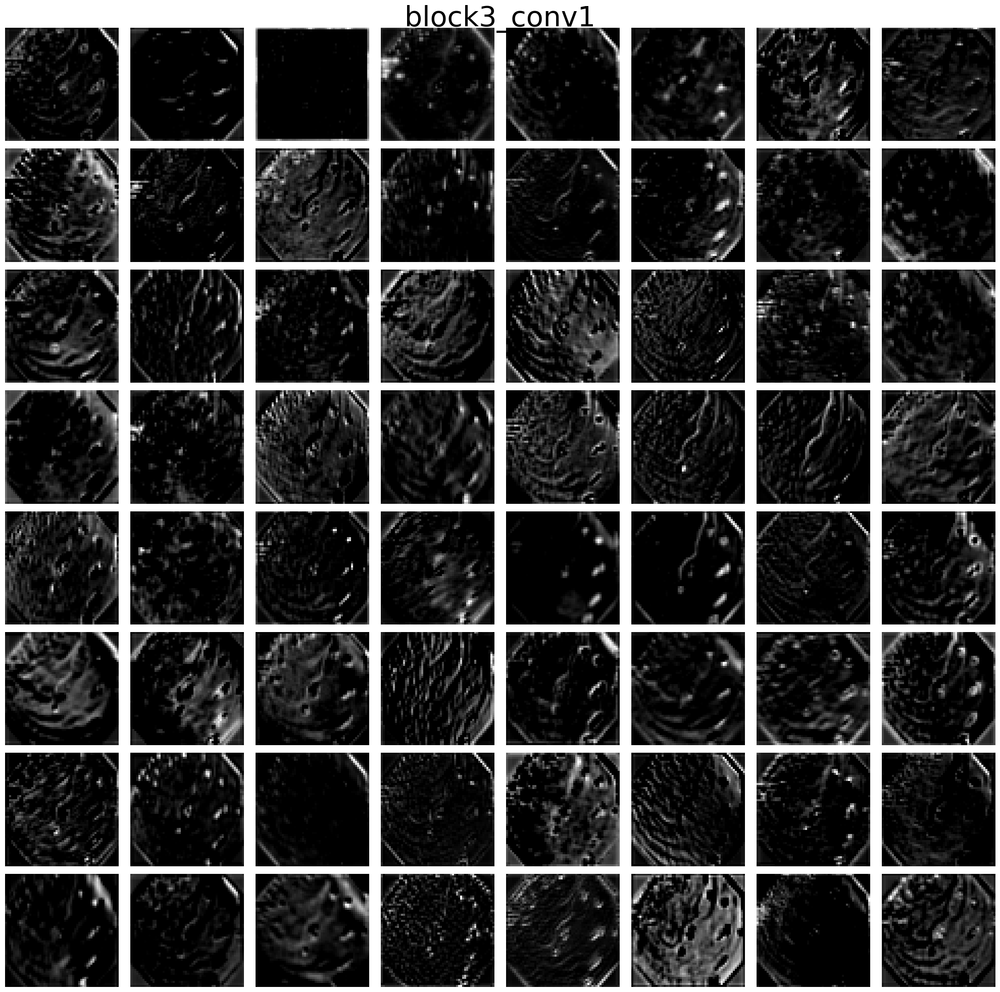

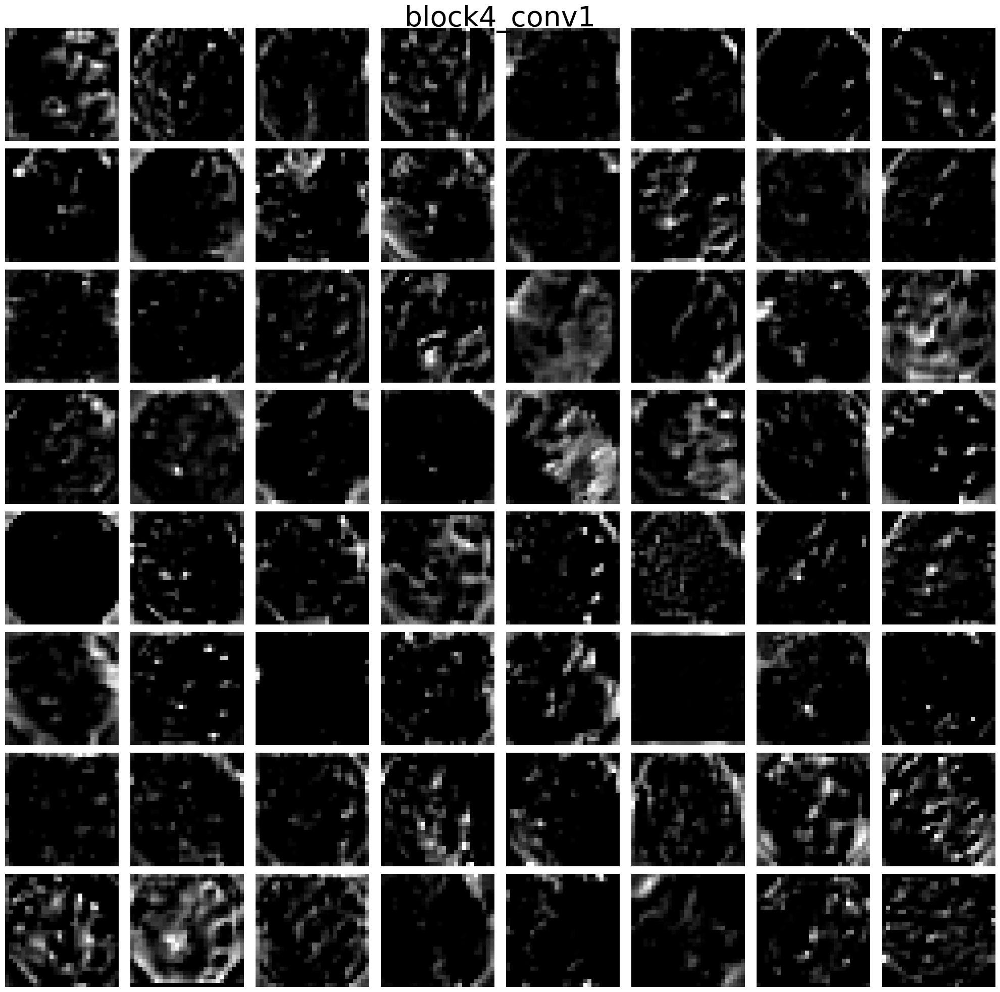

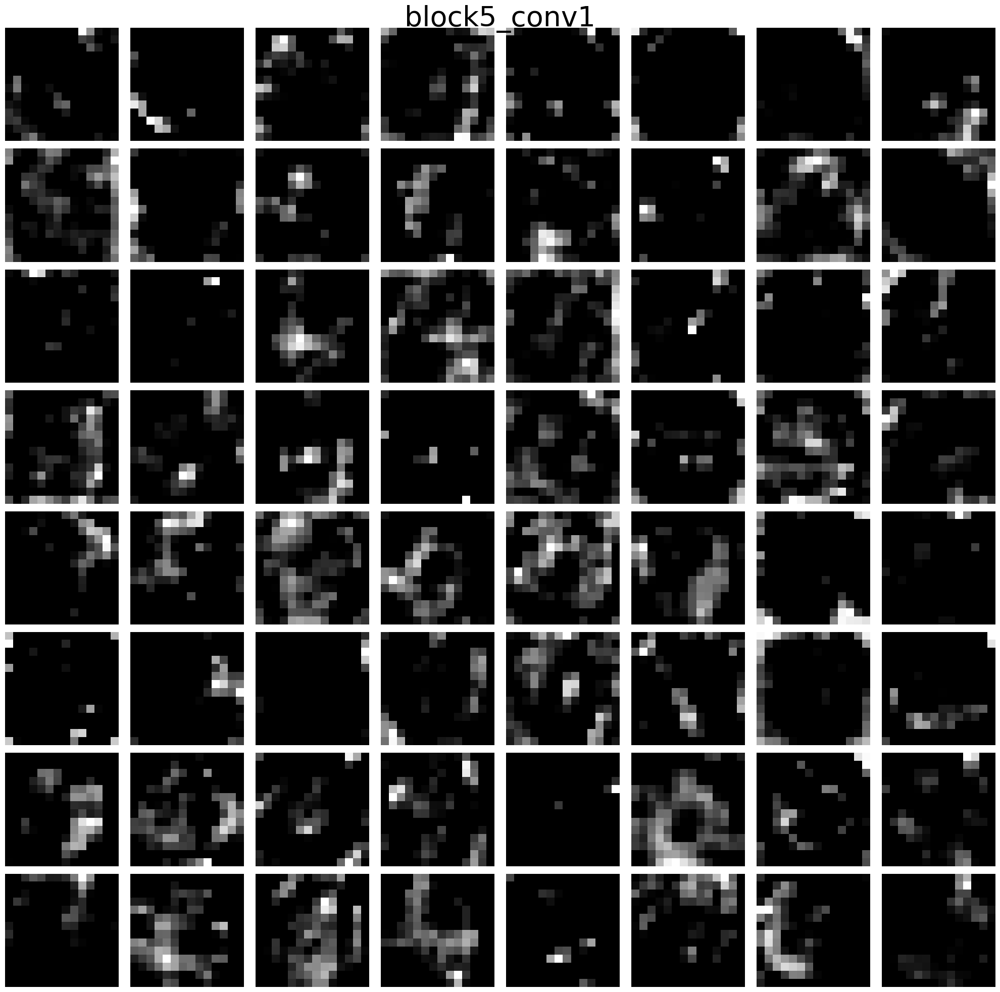

In [ ]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg16 import preprocess_input, decode_predictions

# Load the pre-trained VGG16 model with the specified input shape and freeze the layers.
model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
for layer in model.layers:
    layer.trainable = False

# Choose an image to visualize the feature maps
img_path = '/content/labeled-images/lower-gi-tract/pathological-findings/polyps/0004a718-546c-41c2-9c69-c4685093a039.jpg'
img = image.load_img(img_path, target_size=(224, 224))
x = image.img_to_array(img)
x = np.expand_dims(x, axis=0)
x = preprocess_input(x)

# Define the layers to visualize
layer_names = ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1']

# Create a model that outputs the feature maps of the chosen layers
outputs = [model.get_layer(name).output for name in layer_names]
vis_model = tf.keras.models.Model(inputs=model.input, outputs=outputs)

# Get the feature maps of the chosen layers for the input image
feature_maps = vis_model.predict(x)

# Visualize the feature maps
for i, fmap in enumerate(feature_maps):
    plt.figure(figsize=(20, 20))
    plt.suptitle(layer_names[i], fontsize=40)
    num_fmaps = fmap.shape[-1]
    if num_fmaps > 64:
        num_fmaps = 64
        fmap = fmap[:, :, :, :num_fmaps]
    for j in range(num_fmaps):
        plt.subplot(8, 8, j+1)
        plt.imshow(fmap[0, :, :, j], cmap='gray')
        plt.axis('off')
    plt.tight_layout()
    plt.show()


In [ ]:
from sklearn.metrics import classification_report
print(classification_report(np.argmax(y, axis=1), np.argmax(predict_test, axis=1)))
     

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        20
           1       0.86      0.99      0.92       134
           2       0.00      0.00      0.00         2
           3       0.96      0.98      0.97       207
           4       0.98      0.96      0.97       171

    accuracy                           0.94       534
   macro avg       0.56      0.59      0.57       534
weighted avg       0.90      0.94      0.92       534



/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
from sklearn.metrics import precision_score, recall_score, f1_score
precision_score(np.argmax(y, axis=1), np.argmax(predict_test, axis=1), average='weighted')

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0.9023063562114958

In [ ]:
np.average(recall_score(np.argmax(y, axis=1), np.argmax(predict_test, axis=1), average=None))


0.5876251845274012

In [ ]:
np.average(f1_score(np.argmax(y, axis=1), np.argmax(predict_test, axis=1), average=None))

0.5730982424867874

In [ ]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(np.argmax(y, axis=1), np.argmax(predict_test, axis=1))

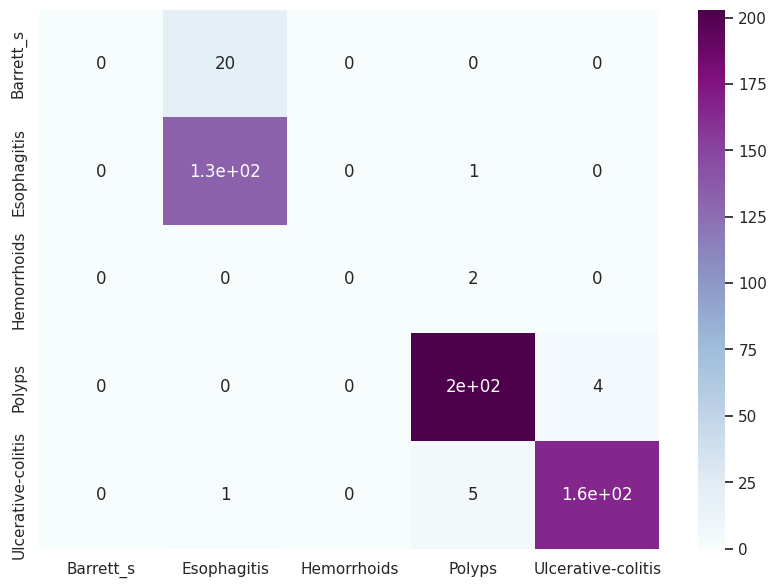

In [ ]:
import seaborn as sn
import pandas as pd
import matplotlib.pyplot as plt

df_cm = pd.DataFrame(cm, columns=class_names, index=class_names)
plt.figure(figsize=(10,7))
sn.set(font_scale=1) # for label size
sn.heatmap(df_cm, annot=True, annot_kws={"size": 12}, cmap="BuPu") # font size

plt.show()

In [ ]:
df_cm

,Barrett_s,Esophagitis,Hemorrhoids,Polyps,Ulcerative-colitis
Barrett_s,0,20,0,0,0
Esophagitis,0,133,0,1,0
Hemorrhoids,0,0,0,2,0
Polyps,0,0,0,203,4
Ulcerative-colitis,0,1,0,5,165


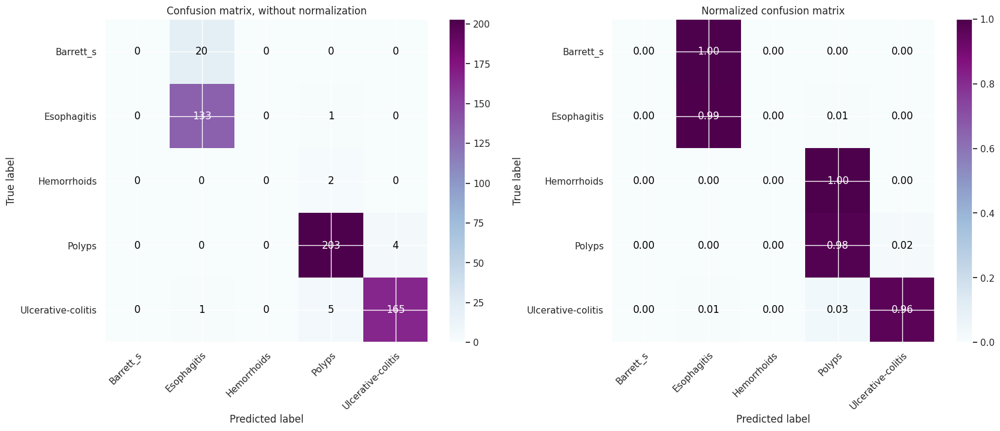

In [ ]:
cm = confusion_matrix(np.argmax(y, axis=1), np.argmax(predict_test, axis=1))
plt_confusion_mat(cm, classes=class_names, fig_size=(20, 7))

Densenet-169

In [ ]:
from keras.applications.densenet import DenseNet169
from keras.models import Model
from keras.layers import Dense
from keras.layers import Flatten

from keras import layers
from keras import optimizers
from tensorflow.keras import regularizers

# load model without classifier layers
model = DenseNet169(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
# add new classifier layers
flat = Flatten()(model.layers[-1].output)
drop1 = layers.Dropout(0.4)(flat)
class1 = Dense(512, activation='relu', kernel_regularizer=regularizers.l2(1e-4))(drop1)
drop2 = layers.Dropout(0.4)(class1)
class2 = Dense(256, activation='relu', kernel_regularizer=regularizers.l2(1e-4))(drop2)
drop3 = layers.Dropout(0.4)(class2)
class3 = Dense(128, activation='relu', kernel_regularizer=regularizers.l2(1e-4))(drop3)
drop4 = layers.Dropout(0.4)(class3)
class4 = Dense(64, activation='relu', kernel_regularizer=regularizers.l2(1e-4))(drop4)
drop5 = layers.Dropout(0.4)(class4)
output = Dense(5, activation='softmax', kernel_regularizer=regularizers.l2(1e-4))(drop5)


# define new model
model = Model(inputs=model.inputs, outputs=output)
# summarize
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d_2 (ZeroPadding2  (None, 230, 230, 3)  0          ['input_2[0][0]']                
 D)                                                                                               
                                                                                                  
 conv1/conv (Conv2D)            (None, 112, 112, 64  9408        ['zero_padding2d_2[0][0]']       
                                )                                                           

In [ ]:
model.compile(
  optimizer=optimizers.RMSprop(learning_rate=2e-5),
  loss="categorical_crossentropy",
  metrics=['accuracy'])

In [ ]:
history2 = model.fit(
  train_ds_norm,
  epochs=20,
  validation_data = val_ds_norm
)

Epoch 1/20
50/50 [==============================] - 61s 556ms/step - loss: 2.5980 - accuracy: 0.2086 - val_loss: 1.4287 - val_accuracy: 0.5527
Epoch 2/20
50/50 [==============================] - 24s 484ms/step - loss: 1.9230 - accuracy: 0.3274 - val_loss: 1.2868 - val_accuracy: 0.5605
Epoch 3/20
50/50 [==============================] - 25s 491ms/step - loss: 1.6535 - accuracy: 0.4128 - val_loss: 1.1211 - val_accuracy: 0.6309
Epoch 4/20
50/50 [==============================] - 25s 492ms/step - loss: 1.5046 - accuracy: 0.4741 - val_loss: 0.9432 - val_accuracy: 0.7070
Epoch 5/20
50/50 [==============================] - 24s 482ms/step - loss: 1.3347 - accuracy: 0.5386 - val_loss: 0.7378 - val_accuracy: 0.8496
Epoch 6/20
50/50 [==============================] - 24s 476ms/step - loss: 1.2431 - accuracy: 0.5841 - val_loss: 0.6179 - val_accuracy: 0.8711
Epoch 7/20
50/50 [==============================] - 24s 476ms/step - loss: 1.0666 - accuracy: 0.6536 - val_loss: 0.5192 - val_accuracy: 0.8984

In [ ]:
model.evaluate(test_ds_norm)

17/17 [==============================] - 2s 119ms/step - loss: 0.6246 - accuracy: 0.9401


[0.6245806813240051, 0.9400749206542969]

In [ ]:
predict_test = model.predict(test_ds_norm)

17/17 [==============================] - 4s 111ms/step


In [ ]:
predict_test.shape

(534, 5)

In [ ]:
model.save("densenet.h5")

In [ ]:
from keras.models import load_model
model_dn = load_model('densenet.h5')
     

In [ ]:
model_dn.summary ()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d_2 (ZeroPadding2  (None, 230, 230, 3)  0          ['input_2[0][0]']                
 D)                                                                                               
                                                                                                  
 conv1/conv (Conv2D)            (None, 112, 112, 64  9408        ['zero_padding2d_2[0][0]']       
                                )                                                           

In [ ]:
dn_features_model = Model (model_dn.layers[0].input,  model_dn.layers[597].output)

In [ ]:
dn_features_model.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d_2 (ZeroPadding2  (None, 230, 230, 3)  0          ['input_2[0][0]']                
 D)                                                                                               
                                                                                                  
 conv1/conv (Conv2D)            (None, 112, 112, 64  9408        ['zero_padding2d_2[0][0]']       
                                )                                                           

In [ ]:
pred_test = model.predict(test_ds_norm)

17/17 [==============================] - 2s 115ms/step


In [ ]:
from sklearn.metrics import precision_score, recall_score, f1_score
np.average(precision_score(np.argmax(y, axis=1), np.argmax(pred_test, axis=1), average='weighted'))

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0.9046830357408057

In [ ]:
from sklearn.metrics import confusion_matrix
#cm = confusion_matrix(np.argmax(y, axis=1), np.argmax(predict_test, axis=1))
#cm = confusion_matrix(np.argmax(y_test, axis=1), np.argmax(pred_test, axis=1))
cm = confusion_matrix(np.argmax(y, axis=1), np.argmax(pred_test, axis=1))

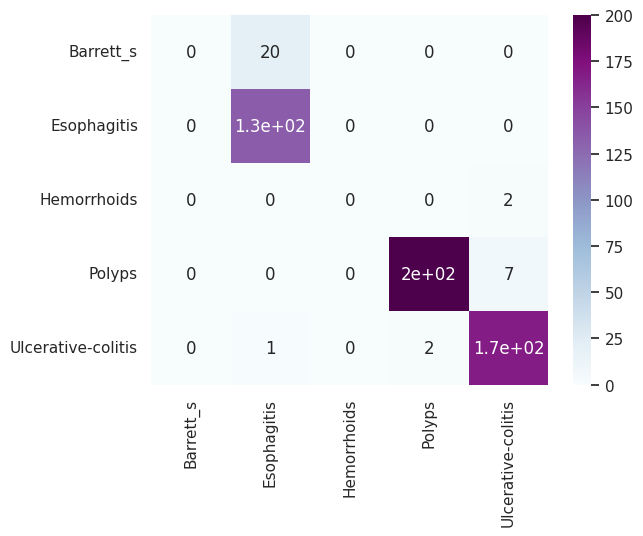

In [ ]:
import seaborn as sn
import pandas as pd
import matplotlib.pyplot as plt

df_cm = pd.DataFrame(cm, columns=class_names, index=class_names)
# plt.figure(figsize=(10,7))
sn.set(font_scale=1) # for label size
sn.heatmap(df_cm, annot=True, annot_kws={"size": 12}, cmap="BuPu") # font size

plt.show()
     

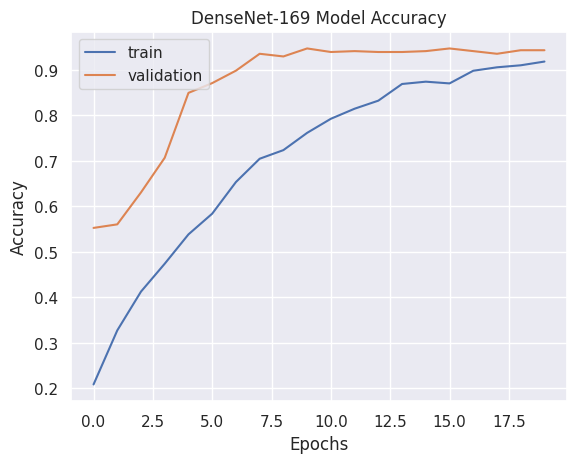

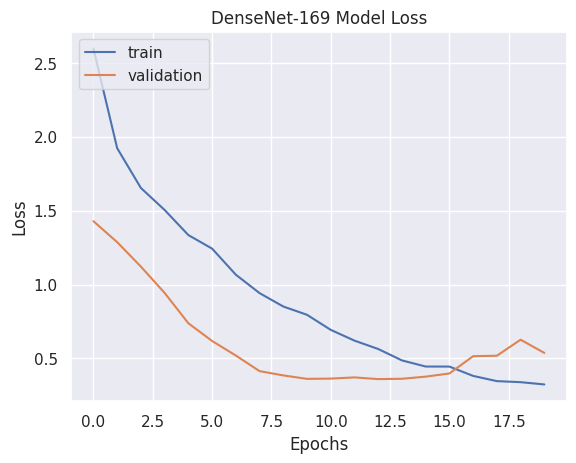

In [ ]:
import matplotlib.pyplot as plt

# Plotting accuracy graph
plt.plot(history2.history['accuracy'])
plt.plot(history2.history['val_accuracy'])
plt.title('DenseNet-169 Model Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

# Plotting loss graph
plt.plot(history2.history['loss'])
plt.plot(history2.history['val_loss'])
plt.title('DenseNet-169 Model Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

1/1 [==============================] - 4s 4s/step


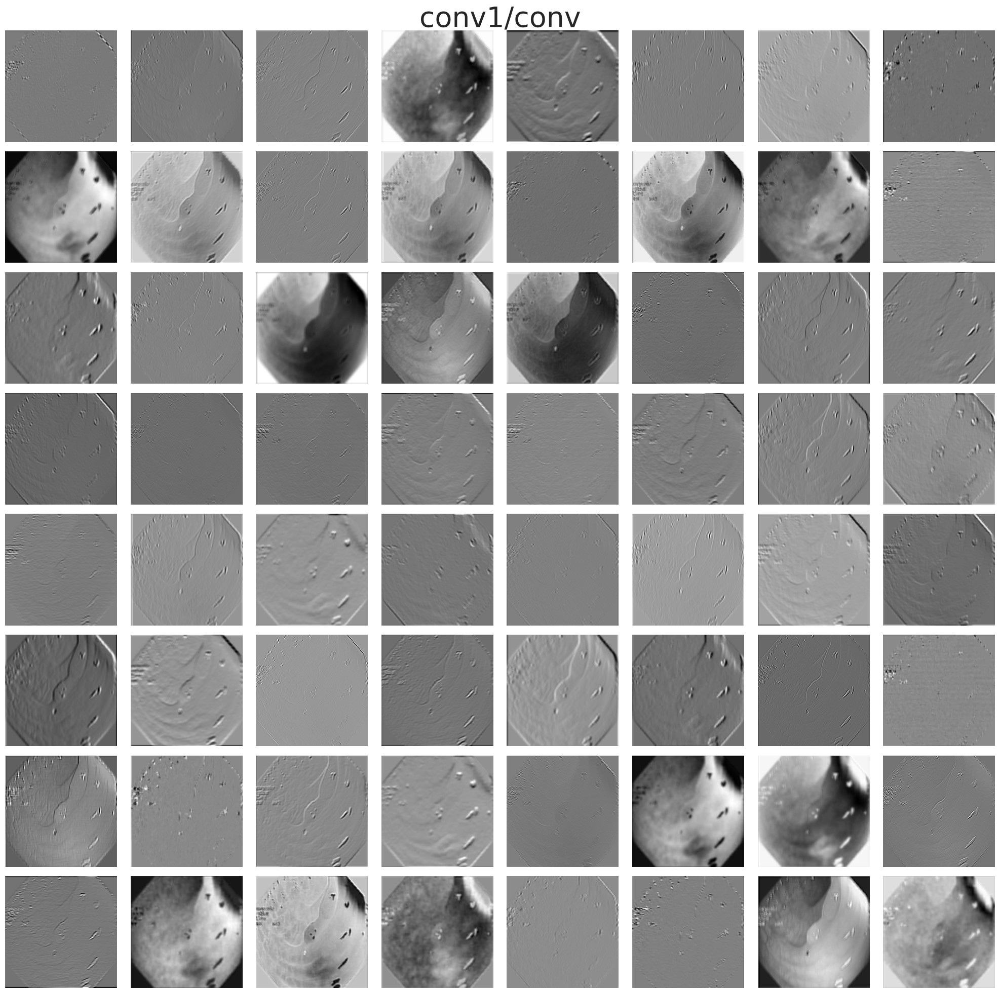

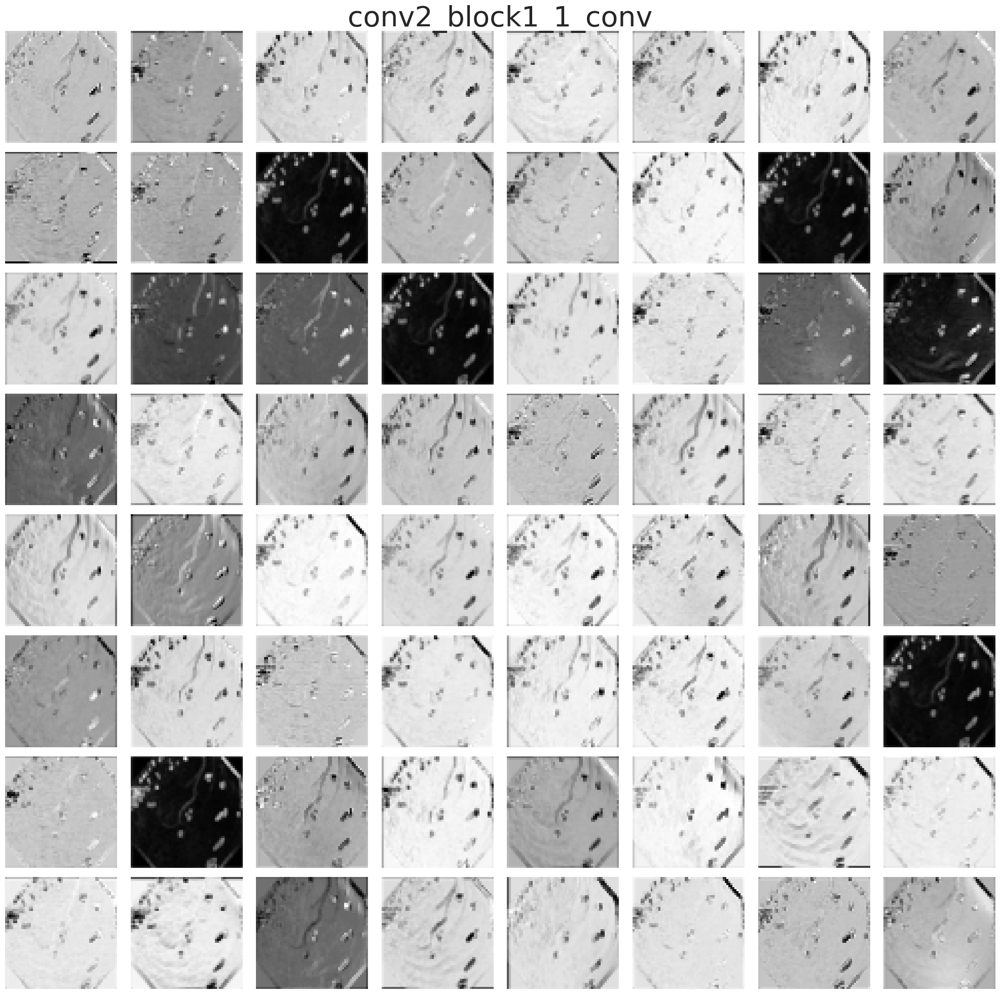

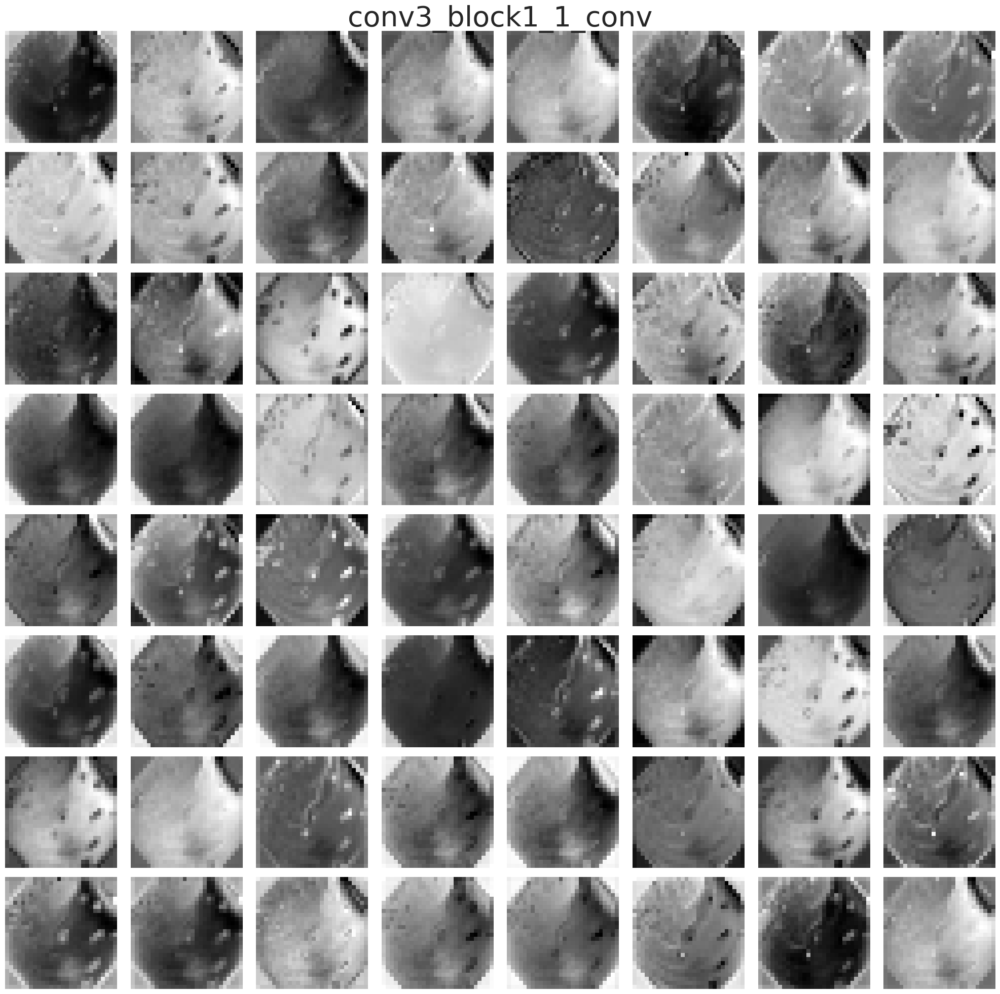

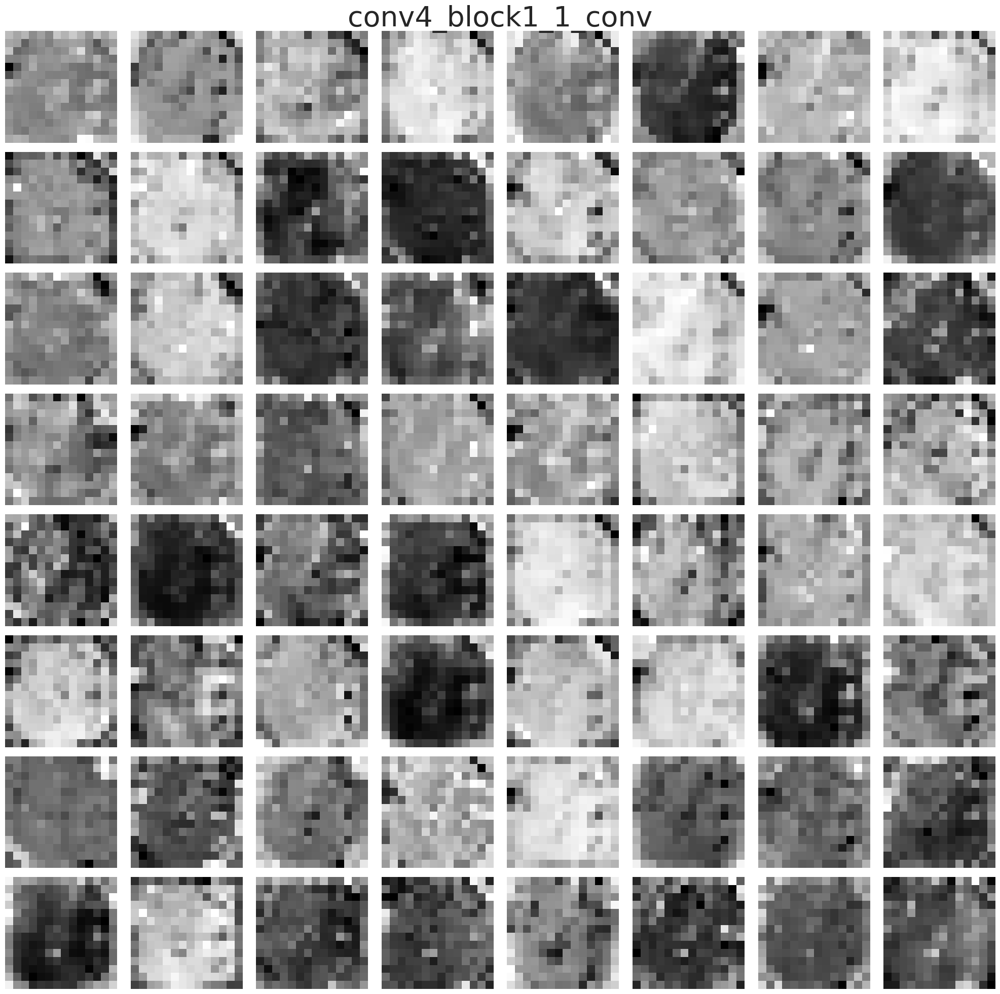

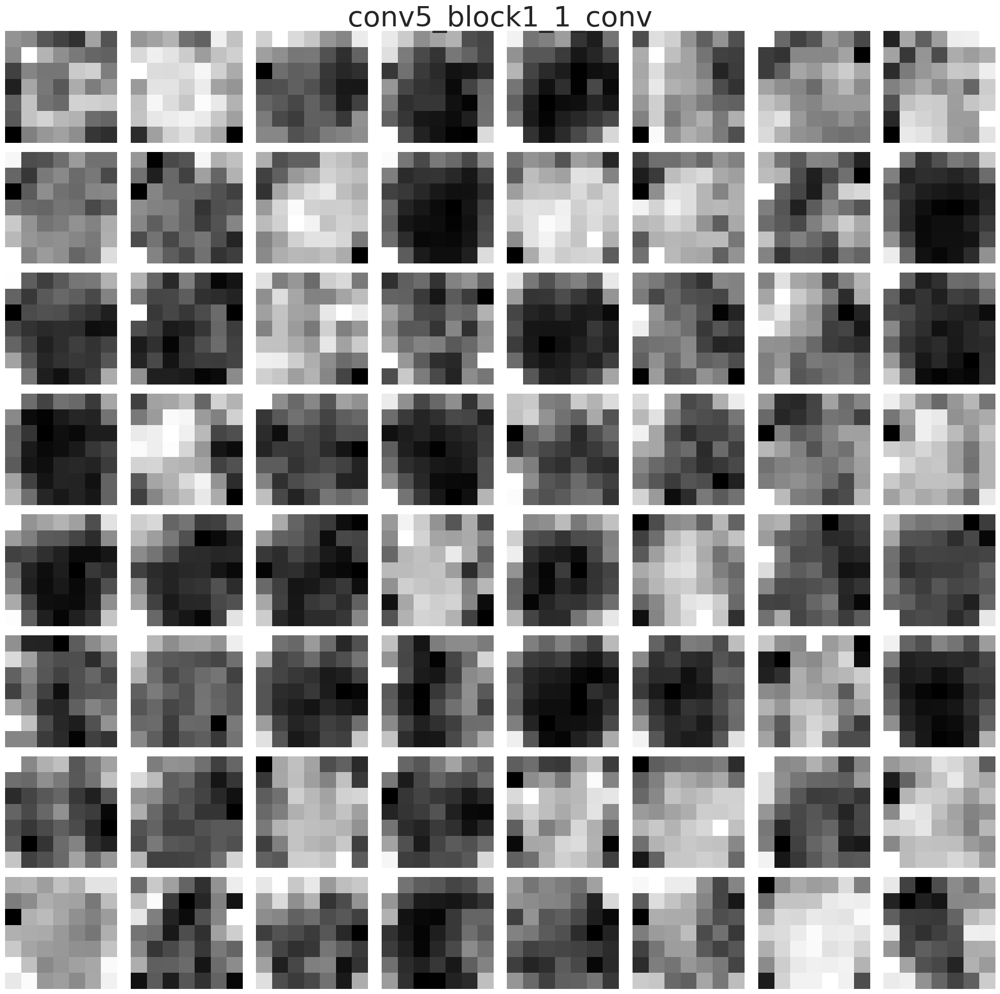

In [ ]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg16 import preprocess_input, decode_predictions

'''model = DenseNet169(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
for layer in model.layers:
    layer.trainable = False'''

# Choose an image to visualize the feature maps
img_path = '/content/labeled-images/lower-gi-tract/pathological-findings/polyps/0004a718-546c-41c2-9c69-c4685093a039.jpg'
img = image.load_img(img_path, target_size=(224, 224))
x = image.img_to_array(img)
x = np.expand_dims(x, axis=0)
x = preprocess_input(x)

# Define the layers to visualize
layer_names = ['conv1/conv', 'conv2_block1_1_conv', 'conv3_block1_1_conv', 'conv4_block1_1_conv', 'conv5_block1_1_conv']

# Create a model that outputs the feature maps of the chosen layers
outputs = [model.get_layer(name).output for name in layer_names]
vis_model = tf.keras.models.Model(inputs=model.input, outputs=outputs)

# Get the feature maps of the chosen layers for the input image
feature_maps = vis_model.predict(x)

# Visualize the feature maps
for i, fmap in enumerate(feature_maps):
    plt.figure(figsize=(20, 20))
    plt.suptitle(layer_names[i], fontsize=40)
    num_fmaps = fmap.shape[-1]
    if num_fmaps > 64:
        num_fmaps = 64
        fmap = fmap[:, :, :, :num_fmaps]
    for j in range(num_fmaps):
        plt.subplot(8, 8, j+1)
        plt.imshow(fmap[0, :, :, j], cmap='gray')
        plt.axis('off')
    plt.tight_layout()
    plt.show()


Efficent Net B0

In [ ]:
from keras.applications.efficientnet import EfficientNetB0
from keras.models import Model
from keras.layers import Dense
from keras.layers import Flatten

from keras import layers
from keras import optimizers
from tensorflow.keras import regularizers


# load model without classifier layers
model = EfficientNetB0(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
# add new classifier layers
flat = Flatten()(model.layers[-1].output)
drop1 = layers.Dropout(0.3)(flat)
class1 = Dense(128, activation='relu', kernel_regularizer=regularizers.l2(1e-4))(drop1)
drop2 = layers.Dropout(0.3)(class1)
class2 = Dense(128, activation='relu', kernel_regularizer=regularizers.l2(1e-4))(drop2)
drop3 = layers.Dropout(0.3)(class2)
class3 = Dense(64, activation='relu', kernel_regularizer=regularizers.l2(1e-4))(drop3)
drop4 = layers.Dropout(0.3)(class2)
class4 = Dense(64, activation='relu', kernel_regularizer=regularizers.l2(1e-4))(drop4)
drop5 = layers.Dropout(0.3)(class2)
output = Dense(5, activation='softmax', kernel_regularizer=regularizers.l2(1e-4))(drop5)

# define new model
model = Model(inputs=model.inputs, outputs=output)
# summarize
model.summary()

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling_9 (Rescaling)        (None, 224, 224, 3)  0           ['input_5[0][0]']                
                                                                                                  
 normalization_3 (Normalization  (None, 224, 224, 3)  7          ['rescaling_9[0][0]']            
 )                                                                                                
                                                                                            

In [ ]:
model.compile(
  optimizer=optimizers.RMSprop(learning_rate=2e-5),
  loss="categorical_crossentropy",
  metrics=['accuracy'])

In [ ]:
history = model.fit(
  train_ds_norm,
  epochs=20,
  validation_data = val_ds_norm
)

Epoch 1/20
50/50 [==============================] - 32s 331ms/step - loss: 1.2156 - accuracy: 0.5329 - val_loss: 2.0583 - val_accuracy: 0.2578
Epoch 2/20
50/50 [==============================] - 14s 288ms/step - loss: 0.6522 - accuracy: 0.7807 - val_loss: 2.4327 - val_accuracy: 0.2578
Epoch 3/20
50/50 [==============================] - 15s 298ms/step - loss: 0.4768 - accuracy: 0.8565 - val_loss: 2.4936 - val_accuracy: 0.2578
Epoch 4/20
50/50 [==============================] - 14s 286ms/step - loss: 0.3720 - accuracy: 0.8900 - val_loss: 2.8519 - val_accuracy: 0.2578
Epoch 5/20
50/50 [==============================] - 14s 285ms/step - loss: 0.2753 - accuracy: 0.9204 - val_loss: 3.1652 - val_accuracy: 0.2598
Epoch 6/20
50/50 [==============================] - 14s 289ms/step - loss: 0.2454 - accuracy: 0.9305 - val_loss: 2.3006 - val_accuracy: 0.1094
Epoch 7/20
50/50 [==============================] - 15s 291ms/step - loss: 0.2073 - accuracy: 0.9431 - val_loss: 1.3819 - val_accuracy: 0.4688

In [ ]:
model.evaluate(test_ds_norm)

17/17 [==============================] - 1s 63ms/step - loss: 0.5839 - accuracy: 0.8127


[0.5838652849197388, 0.812734067440033]

In [ ]:
predict_test = model.predict(test_ds_norm)

17/17 [==============================] - 2s 59ms/step


In [ ]:
predict_test.shape

(534, 5)

In [ ]:
from sklearn.metrics import precision_score, recall_score, f1_score
np.average(precision_score(np.argmax(y, axis=1), np.argmax(pred_test, axis=1), average='weighted'))

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0.8445112238206464

In [ ]:
from sklearn.metrics import confusion_matrix
#cm = confusion_matrix(np.argmax(y, axis=1), np.argmax(predict_test, axis=1))
#cm = confusion_matrix(np.argmax(y_test, axis=1), np.argmax(pred_test, axis=1))
cm = confusion_matrix(np.argmax(y, axis=1), np.argmax(pred_test, axis=1))

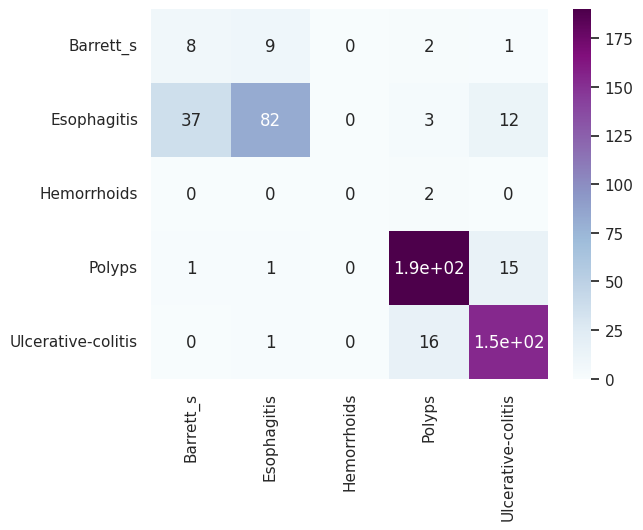

In [ ]:
import seaborn as sn
import pandas as pd
import matplotlib.pyplot as plt

df_cm = pd.DataFrame(cm, columns=class_names, index=class_names)
# plt.figure(figsize=(10,7))
sn.set(font_scale=1) # for label size
sn.heatmap(df_cm, annot=True, annot_kws={"size": 12}, cmap="BuPu") # font size

plt.show()
     

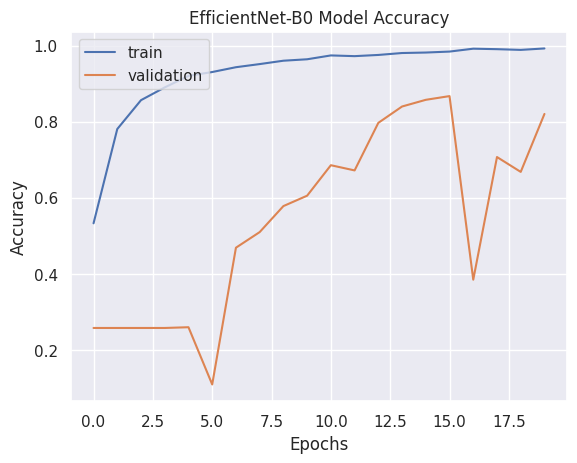

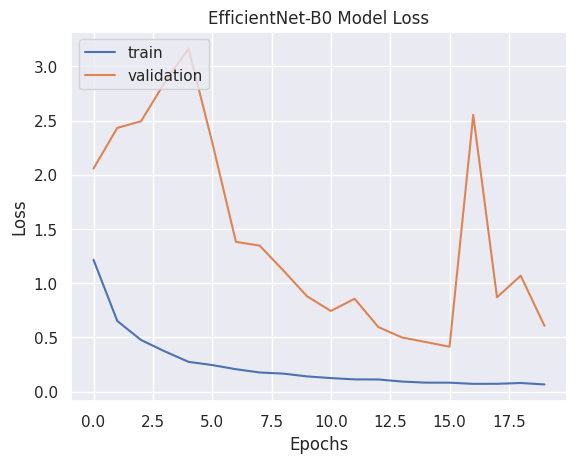

In [ ]:
import matplotlib.pyplot as plt

# Plotting accuracy graph
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('EfficientNet-B0 Model Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

# Plotting loss graph
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('EfficientNet-B0 Model Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

Inception-V3

In [ ]:
from tensorflow.keras.applications.inception_v3 import InceptionV3
from keras.models import Model
from keras.layers import Dense
from keras.layers import Flatten

from keras import layers
from keras import optimizers
from tensorflow.keras import regularizers

# load model without classifier layers
model = InceptionV3(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
# add new classifier layers
flat = Flatten()(model.layers[-1].output)
drop1 = layers.Dropout(0.4)(flat)
class1 = Dense(512, activation='relu', kernel_regularizer=regularizers.l2(1e-4))(drop1)
drop2 = layers.Dropout(0.4)(class1)
class2 = Dense(256, activation='relu', kernel_regularizer=regularizers.l2(1e-4))(drop2)
drop3 = layers.Dropout(0.4)(class2)
class3 = Dense(128, activation='relu', kernel_regularizer=regularizers.l2(1e-4))(drop3)
drop4 = layers.Dropout(0.4)(class3)
class4 = Dense(64, activation='relu', kernel_regularizer=regularizers.l2(1e-4))(drop4)
drop5 = layers.Dropout(0.4)(class4)
output = Dense(5, activation='softmax', kernel_regularizer=regularizers.l2(1e-4))(drop5)


# define new model
model = Model(inputs=model.inputs, outputs=output)
# summarize
model.summary()

Model: "model_7"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_10 (InputLayer)          [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_188 (Conv2D)            (None, 111, 111, 32  864         ['input_10[0][0]']               
                                )                                                                 
                                                                                                  
 batch_normalization_188 (Batch  (None, 111, 111, 32  96         ['conv2d_188[0][0]']             
 Normalization)                 )                                                           

In [ ]:
model.compile(
  optimizer=optimizers.RMSprop(learning_rate=2e-5),
  loss="categorical_crossentropy",
  metrics=['accuracy'])

In [ ]:
history = model.fit(
  train_ds_norm,
  epochs=20,
  validation_data = val_ds_norm
)

Epoch 1/20
50/50 [==============================] - 28s 285ms/step - loss: 2.0271 - accuracy: 0.2630 - val_loss: 1.3945 - val_accuracy: 0.4160
Epoch 2/20
50/50 [==============================] - 13s 259ms/step - loss: 1.7618 - accuracy: 0.3180 - val_loss: 1.2162 - val_accuracy: 0.5527
Epoch 3/20
50/50 [==============================] - 13s 263ms/step - loss: 1.5398 - accuracy: 0.4362 - val_loss: 0.9585 - val_accuracy: 0.7715
Epoch 4/20
50/50 [==============================] - 13s 263ms/step - loss: 1.2892 - accuracy: 0.5386 - val_loss: 0.7393 - val_accuracy: 0.8418
Epoch 5/20
50/50 [==============================] - 13s 264ms/step - loss: 1.1253 - accuracy: 0.6163 - val_loss: 0.6364 - val_accuracy: 0.8633
Epoch 6/20
50/50 [==============================] - 13s 268ms/step - loss: 0.9296 - accuracy: 0.7149 - val_loss: 0.5576 - val_accuracy: 0.8828
Epoch 7/20
50/50 [==============================] - 13s 267ms/step - loss: 0.8381 - accuracy: 0.7554 - val_loss: 0.5122 - val_accuracy: 0.9004

In [ ]:
model.evaluate(test_ds_norm)

17/17 [==============================] - 1s 82ms/step - loss: 0.8103 - accuracy: 0.9288


[0.810295045375824, 0.9288389682769775]

In [ ]:
predict_test = model.predict(test_ds_norm)

17/17 [==============================] - 2s 71ms/step


In [ ]:
predict_test.shape

(534, 5)

In [ ]:
from sklearn.metrics import precision_score, recall_score, f1_score
np.average(precision_score(np.argmax(y, axis=1), np.argmax(pred_test, axis=1), average='weighted'))

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


0.8445112238206464

In [ ]:
from sklearn.metrics import confusion_matrix
#cm = confusion_matrix(np.argmax(y, axis=1), np.argmax(predict_test, axis=1))
#cm = confusion_matrix(np.argmax(y_test, axis=1), np.argmax(pred_test, axis=1))
cm = confusion_matrix(np.argmax(y, axis=1), np.argmax(pred_test, axis=1))

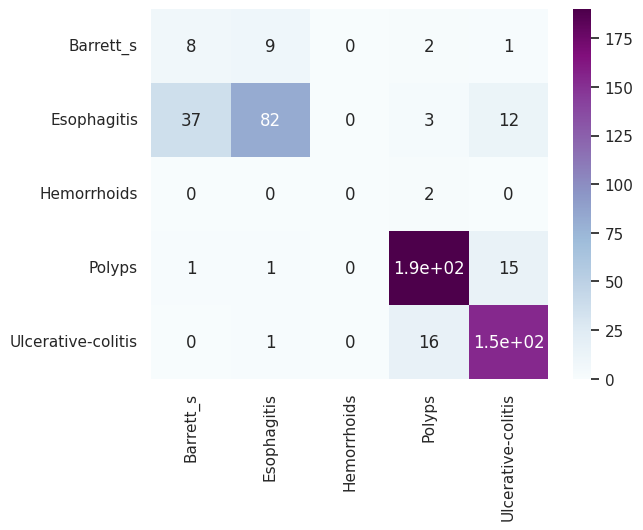

In [ ]:
import seaborn as sn
import pandas as pd
import matplotlib.pyplot as plt

df_cm = pd.DataFrame(cm, columns=class_names, index=class_names)
# plt.figure(figsize=(10,7))
sn.set(font_scale=1) # for label size
sn.heatmap(df_cm, annot=True, annot_kws={"size": 12}, cmap="BuPu") # font size

plt.show()
     

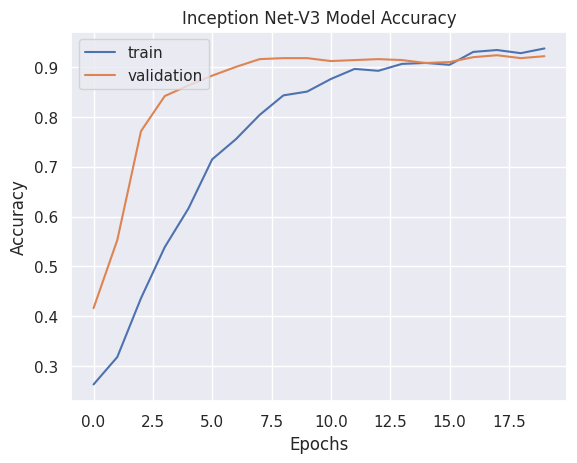

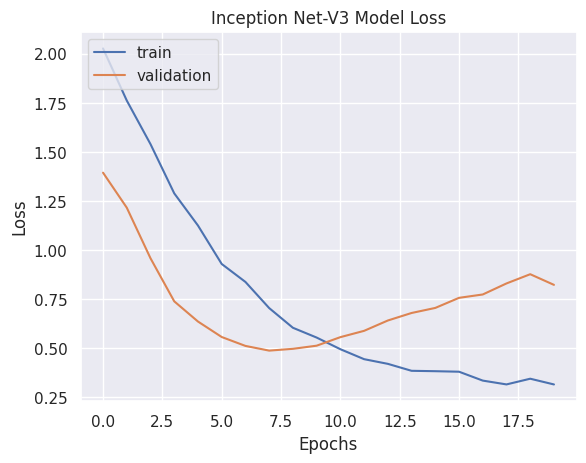

In [ ]:
import matplotlib.pyplot as plt

# Plotting accuracy graph
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Inception Net-V3 Model Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

# Plotting loss graph
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Inception Net-V3 Model Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()